In [1]:
%matplotlib inline

In [2]:
from datetime import datetime
import os
from os.path import dirname, abspath, join
from os import getcwd
import sys

In [3]:
import random
import string
import pandas as pd
import numpy as np

In [4]:
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker

In [5]:
import torch
import socket
from IPython.display import clear_output

In [6]:
# seed_arg = int(sys.argv[1])
# print ("\n\nSeed ARG: ",seed_arg)
seed_arg = 1

In [7]:
seedlist = np.array([161, 314, 228, 271828, 230, 4271031, 5526538, 6610165, 9849252, 34534, 73422, 8765])
seed = seedlist[seed_arg]
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
os.environ['PYTHONHASHSEED'] = str(seed)

In [8]:
NAME       = 'B1'
MODELNAME  = NAME + '_' + str(seed) + '.pt'
print("\nMODEL : ", NAME)
print("SEED  : ",seed_arg)
print("HOST  : ",socket.gethostname())
print("START : ",datetime.now())


MODEL :  B1
SEED  :  1
HOST  :  7574709303cc
START :  2019-03-17 17:40:37.227789


In [9]:
class ENO(object):
    
    #no. of forecast types is 6 ranging from 0 to 5
  
    def __init__(self, location='tokyo', year=2010, shuffle=False, day_balance=False):
        self.location = location
        self.year = year
        self.day = None
        self.hr = None
        
        self.shuffle = shuffle
        self.day_balance = day_balance

        self.TIME_STEPS = None #no. of time steps in one episode
        self.NO_OF_DAYS = None #no. of days in one year
        
        self.NO_OF_DAYTYPE = 10 #no. of daytypes
        self.daycounter = 0 #to count number of days that have been passed
        
        self.sradiation = None #matrix with GSR for the entire year
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #array with forecast values for each day
        

        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
        self.sorted_days = [] #days sorted according to day type
        
        self.SMAX = 1000 # 1 Watt Solar Panel

    
    #function to get the solar data for the given location and year and prep it
    def get_data(self):
        #solar_data/CSV files contain the values of GSR (Global Solar Radiation in MegaJoules per meters squared per hour)
        #weather_data/CSV files contain the weather summary from 06:00 to 18:00 and 18:00 to 06:00+1
        location = self.location
        year = self.year

        THIS_DIR = getcwd()
        SDATA_DIR = abspath(join(THIS_DIR, 'solar_data'))  #abspath(join(THIS_DIR, '../../..', 'data'))
        
        sfile = SDATA_DIR + '/' + location +'/' + str(year) + '.csv'
        
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(sfile, skiprows=4, encoding='shift_jisx0213', usecols=[4])
      
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values

        #convert missing data in CSV files to zero
        solar_radiation[np.isnan(solar_radiation)] = 0

        #reshape solar_radiation into no_of_daysx24 array
        solar_radiation = solar_radiation.reshape(-1,24)

        if(self.shuffle): #if class instatiation calls for shuffling the day order. Required when learning
            np.random.shuffle(solar_radiation) 
        self.sradiation = solar_radiation
        
        #GSR values (in MJ/sq.mts per hour) need to be expressed in mW
        # Conversion is accomplished by 
        # solar_energy = GSR(in MJ/m2/hr) * 1e6 * size of solar cell * efficiency of solar cell /(60x60) *1000 (to express in mW)
        # the factor of 2 in the end is assuming two solar cells
        self.senergy = 2*self.sradiation * 1e6 * (55e-3 * 70e-3) * 0.15 * 1000/(60*60)

        return 0
    
    #function to map total day radiation into type of day ranging from 0 to 5
    #the classification into day types is quite arbitrary. There is no solid logic behind this type of classification.
    
    def get_day_state(self,tot_day_radiation):
        bin_edges = np.array([0, 3.5, 6.5, 9.0, 12.5, 15.5, 18.5, 22.0, 25, 28])
        for k in np.arange(1,bin_edges.size):
            if (bin_edges[k-1] < tot_day_radiation <= bin_edges[k]):
                day_state = k -1
            else:
                day_state = bin_edges.size - 1
        return int(day_state)
    
    def get_forecast(self):
        #create a perfect forecaster.
        tot_day_radiation = np.sum(self.sradiation, axis=1) #contains total solar radiation for each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_radiation)
        
        #sort days depending on the type of day and shuffle them; maybe required when learning
        for fcast in range(0,6):
            fcast_days = ([i for i,x in enumerate(self.fforecast) if x == fcast])
            np.random.shuffle(fcast_days)
            self.sorted_days.append(fcast_days)
        return 0
    
    def reset(self,day=0): #it is possible to reset to the beginning of a certain day
        
        self.get_data() #first get data for the given year
        self.get_forecast() #calculate the forecast
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        self.day = day
        self.hr = 0
        
        self.henergy = self.senergy[self.day][self.hr]
        self.fcast = self.fforecast[self.day]
        
        end_of_day = False
        end_of_year = False
        return [self.henergy, self.fcast, end_of_day, end_of_year]

    
    def step(self):
        end_of_day = False
        end_of_year = False
        if not(self.day_balance): #if daytype balance is not required
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                if(self.day < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.hr = 0
                    self.day += 1
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else:
                    end_of_day = True
                    end_of_year = True
                    
        else: #when training, we want all daytypes to be equally represented for robust policy
              #obviously, the days are going to be in random order
            if(self.hr < self.TIME_STEPS - 1):
                self.hr += 1
                self.henergy = self.senergy[self.day][self.hr]
                self.fcast = self.fforecast[self.day]
            else:
                if(self.daycounter < self.NO_OF_DAYS -1):
                    end_of_day = True
                    self.daycounter += 1
                    self.hr = 0
                    daytype = random.choice(np.arange(0,self.NO_OF_DAYTYPE)) #choose random daytype
                    self.day = np.random.choice(self.sorted_days[daytype]) #choose random day from that daytype
                    self.henergy = self.senergy[self.day][self.hr] 
                    self.fcast = self.fforecast[self.day]
                else: 
                    end_of_day = True
                    end_of_year = True
                    self.daycounter = 0
        
        
        return [self.henergy, self.fcast, end_of_day, end_of_year]

In [10]:
class CAPM (object):
    def __init__(self,location='tokyo', year=2010, shuffle=False, trainmode=False):

        #all energy values i.e. BMIN, BMAX, BOPT, HMAX are in mWhr. Assuming one timestep is one hour
        
        self.BMIN = 0.0                #Minimum battery level that is tolerated. Maybe non-zero also
        self.BMAX = 10000.0            #Max Battery Level. May not necessarily be equal to total batter capacity [3.6V x 2500mAh]
        self.BOPT = 0.5 * self.BMAX    #Optimal Battery Level. Assuming 50% of battery is the optimum
        self.BLIM_LO = 0.15*self.BMAX
        self.BLIM_HI = 0.95*self.BMAX
        self.BSAFE_LO = 0.35*self.BMAX
        self.BSAFE_HI = 0.65*self.BMAX
        
        self.ENP_MARGIN = 0.3*self.BMAX

        
        self.HMIN = 0      #Minimum energy that can be harvested by the solar panel.
        self.HMAX = None   #Maximum energy that can be harvested by the solar panel. [500mW]
        
        self.DMAX = 500      #Maximum energy that can be consumed by the node in one time step. [~ 3.6V x 135mA]
        self.N_ACTIONS = 10  #No. of different duty cycles possible
        self.DMIN = self.DMAX/self.N_ACTIONS #Minimum energy that can be consumed by the node in one time step. [~ 3.6V x 15mA]
        
        self.binit = None     #battery at the beginning of day
        self.btrack = []      #track the mean battery level for each day
        self.atrack = []      #track the duty cycles for each day
        self.htrack = []      #track the harvested for each day
        self.batt = None      #battery variable
        self.enp = None       #enp at end of hr
        self.henergy = None   #harvested energy variable
        self.fcast = None     #forecast variable
        
        self.MUBATT = 0.6
        self.SDBATT = 0.02
        
        self.MUHENERGY = 0.5
        self.SDHENERGY = 0.2
        
        self.MUENP = 0
        self.SDENP = 0.02
        
        self.location  = location
        self.year      = year
        self.shuffle   = shuffle
        self.trainmode = trainmode
        self.eno       = None
        
        self.day_violation_flag = False
        self.violation_flag     = False
        self.violation_counter  = 0
        
        self.batt_violations    = 0

        self.NO_OF_DAYTYPE      = 10 #no. of daytypes
 
    def reset(self,day=0,batt=-1):
        henergy, fcast, day_end, year_end = self.eno.reset(day) #reset the eno environment
        self.violation_flag = False
        self.violation_counter = 0
        self.batt_violations = 0
        
        if(batt == -1):
            self.batt = self.BOPT
        else:
            self.batt = batt
            
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.binit = self.batt
        self.btrack = np.append(self.btrack, self.batt) #track battery levels

        self.enp = self.BOPT - self.batt
#         self.enp = self.binit - self.batt #enp is calculated
        self.henergy = np.clip(henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
        self.fcast = fcast
        
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        reward = 0
        
        return [c_state, reward, day_end, year_end]
    
    def getstate(self): #query the present state of the system
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states

        return c_state
        
    
    #reward function
    def rewardfn(self):
        violation_penalty = 0
        bmean = self.btrack.mean()
        if bmean < self.BLIM_LO or bmean > self.BLIM_HI:
            reward = -np.abs(self.BOPT - bmean)/self.BMAX*5
        else:
            reward = 2
#         reward = 2 - 20*np.abs(bdev)/self.BMAX
        if(self.day_violation_flag):
            violation_penalty += 3    #penalty for violating battery limits anytime during the day
        return (reward - violation_penalty)
    
    def step(self, action):
        day_end = False
        year_end = False
        self.violation_flag = False
        reward = 0
        self.atrack = np.append(self.atrack, action+1) #track duty cycles
        self.htrack = np.append(self.htrack, self.henergy)

#         action_var = np.abs(np.mean(self.atrack) - action)/9 #can vary from 0 to 1
#         reward += 0.25*(0.5 - action_var ) #reward penalizing high duty cycle variance [-0.5 to 0.5]*0.25
      
        action = np.clip(action, 0, self.N_ACTIONS-1) #action values range from (0 to N_ACTIONS-1)
        e_consumed = (action+1)*self.DMAX/self.N_ACTIONS   #energy consumed by the node
        
        
        self.batt += (self.henergy - e_consumed)
        if(self.batt <= self.BMIN or self.batt >= self.BMAX ):
                self.batt_violations += 1
        
        if(self.batt < self.BLIM_LO or self.batt > self.BLIM_HI ):
            self.violation_flag = True #penalty for violating battery limits everytime it happens
#             reward -= 2
#             if(self.batt < self.BLIM_LO): #battery depletion is more fatal than battery overflow
#                 reward -= 2

        if(self.violation_flag):
            if(self.day_violation_flag == False): #penalty for violating battery limits anytime during the day - triggers once everyday
                self.violation_counter += 1
                self.day_violation_flag = True
                
        #calculate ENP before clipping
        self.enp = self.BOPT - self.batt
        
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX) #clip battery values within permitted level
        self.btrack = np.append(self.btrack, self.batt) #track battery levels
        
        
        #proceed to the next time step
       
        self.henergy, self.fcast, day_end, year_end = self.eno.step()
        self.henergy = np.clip(self.henergy, self.HMIN, self.HMAX) #clip henergy within HMIN and HMAX
                        
        if(day_end): #if eno object flags that the day has ended then give reward
            reward += self.rewardfn()
            if (self.trainmode): #reset battery to optimal level if limits are exceeded when training
#                 self.batt = np.random.uniform(self.DMAX*self.eno.TIME_STEPS/self.BMAX,0.8)*self.BMAX
#                 if (self.violation_flag):
                if np.random.uniform() < HELP : #occasionaly reset the battery
                    self.batt = self.BOPT  
            
            self.day_violation_flag = False
            self.binit = self.batt #this will be the new initial battery level for next day
            self.btrack = [] #clear battery tracker
            self.atrack = [] #clear duty cycle tracker
            self.htrack = [] #clear henergy tracker
   
        norm_batt    = self.batt    /self.BMAX
        norm_enp     = self.enp     /self.BMAX
        norm_henergy = self.henergy /self.HMAX
        norm_fcast   = self.fcast   /(self.NO_OF_DAYTYPE-1)
        c_state = [norm_batt, norm_enp, norm_henergy, norm_fcast] #continuous states
        
        return [c_state, reward, day_end, year_end]

In [11]:
# Hyper Parameters
BATCH_SIZE          = 12
WT_DECAY            = None
LR                  = 1e-4          # learning rate
EPSILON             = 0.9           # greedy policy
GAMMA               = 0.9           # reward discount
LAMBDA              = 0.95          # parameter decay
TARGET_REPLACE_ITER = 24*7*4*18     # target update frequency
MEMORY_CAPACITY     = 24*7*4*12*3   # store upto six month worth of memory   

N_ACTIONS           = 10            # no. of duty cycles (0,1,2,3,4)
N_STATES            = 4             # number of state space parameter [batt, enp, henergy, fcast]

HIDDEN_LAYER        = 50            # width of NN
NO_OF_ITERATIONS    = 100
GPU                 = False         # device
HELP                = 0.05

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

#Class definitions for NN model and learning algorithm
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()

        self.fc1 = nn.Linear(N_STATES, HIDDEN_LAYER)
        nn.init.kaiming_uniform_(self.fc1.weight)
        
#         self.fc2 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc2.weight)
        
#         self.fc3 = nn.Linear(HIDDEN_LAYER, HIDDEN_LAYER)
#         nn.init.kaiming_uniform_(self.fc3.weight)

        self.fc_out = nn.Linear(HIDDEN_LAYER, N_ACTIONS)
        nn.init.xavier_uniform_(self.fc_out.weight) 
    
    def forward(self, x):
        x = self.fc1(x)
        x = F.relu(x)
#         x = F.leaky_relu(x)
#         x = self.fc2(x)
#         x = F.relu(x)
#         x = self.fc3(x)
#         x = F.relu(x)
        x = self.fc_out(x)
        return x
    
class DQN(object):
    def __init__(self):
        if(GPU): 
            device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        else:
            device = torch.device('cpu')
        self.eval_net, self.target_net = Net(), Net()
        self.eval_net.to(device)
        self.target_net.to(device)
        self.device = device
#         print("Neural net")
#         print(self.eval_net)
        self.learn_step_counter = 0                                     # for target updating
        self.memory_counter = 0                                         # for storing memory
        self.memory = np.zeros((MEMORY_CAPACITY, N_STATES * 2 + 2))     # initialize memory [mem: ([s], a, r, [s_]) ]
        self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR)
#         self.optimizer = torch.optim.Adam(self.eval_net.parameters(), lr=LR, weight_decay=WT_DECAY)
#         self.loss_func = nn.SmoothL1Loss()
        self.loss_func = nn.MSELoss()
        self.nettoggle = False

    def choose_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        actions_value = self.eval_net.forward(x)
        actions_value = actions_value.to(torch.device("cpu"))
        action = torch.max(actions_value, 1)[1].data.numpy()
        action = action[0] # return the argmax index
        if np.random.uniform() > EPSILON:   # greedy
            action += np.random.randint(-3, 3)
            action = int(np.clip(action, 0, N_ACTIONS-1))
        return action
    
    def choose_greedy_action(self, x):
        x = torch.unsqueeze(torch.FloatTensor(x), 0)
        x = x.to(self.device)

        # input only one sample
        if True:   # greedy
            actions_value = self.eval_net.forward(x)
            actions_value = actions_value.to(torch.device("cpu"))
            action = torch.max(actions_value, 1)[1].data.numpy()
            action = action[0] # return the argmax index
        return action

    def store_transition(self, s, a, r, s_):
        transition = np.hstack((s, [a, r], s_))
        # replace the old memory with new memory
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory[index, :] = transition
        self.memory_counter += 1
    
    def store_day_transition(self, transition_rec):
        data = transition_rec
        index = self.memory_counter % MEMORY_CAPACITY
        self.memory= np.insert(self.memory, index, data,0)
        self.memory_counter += transition_rec.shape[0]

    def learn(self):
        # target parameter update
        if self.learn_step_counter % TARGET_REPLACE_ITER == 0:
            self.target_net.load_state_dict(self.eval_net.state_dict())
            self.nettoggle = not self.nettoggle
        self.learn_step_counter += 1

        # sample batch transitions
        sample_index = np.random.choice(MEMORY_CAPACITY, BATCH_SIZE)
        b_memory = self.memory[sample_index, :]
        b_s = torch.FloatTensor(b_memory[:, :N_STATES])
        b_a = torch.LongTensor(b_memory[:, N_STATES:N_STATES+1].astype(int))
        b_r = torch.FloatTensor(b_memory[:, N_STATES+1:N_STATES+2])
        b_s_ = torch.FloatTensor(b_memory[:, -N_STATES:])
        
        b_s = b_s.to(self.device)
        b_a = b_a.to(self.device)
        b_r = b_r.to(self.device)
        b_s_ = b_s_.to(self.device)

        # q_eval w.r.t the action in experience
        q_eval = self.eval_net(b_s).gather(1, b_a)  # shape (batch, 1)
        q_next = self.target_net(b_s_).detach()     # detach from graph, don't backpropagate
        q_target = b_r + GAMMA * q_next.max(1)[0].view(BATCH_SIZE, 1)   # shape (batch, 1)
        loss = self.loss_func(q_eval, q_target)

        self.optimizer.zero_grad()
        loss.backward()
        self.optimizer.step()

In [13]:
def stdize(s):
    MU_BATT = 0.5
    SD_BATT = 0.15
    
    MU_ENP = 0
    SD_ENP = 0.15
    
    MU_HENERGY = 0.35
    SD_HENERGY = 0.25
    
    MU_FCAST = 0.42
    SD_FCAST = 0.27
    
    norm_batt, norm_enp, norm_henergy, norm_fcast = s
    
    std_batt    = (norm_batt    - MU_BATT    )/SD_BATT
    std_enp     = (norm_enp     - MU_ENP     )/SD_ENP
    std_henergy = (norm_henergy - MU_HENERGY )/SD_HENERGY
    std_fcast   = (norm_fcast   - MU_FCAST   )/SD_FCAST

    return [std_batt, std_enp, std_henergy, std_fcast]


In [14]:
#CONSTANTS
LOCATION = 'tokyo'
YEAR = 2010
capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
print("BMIN       = ", capm.BMIN)
print("BMAX       = ", capm.BMAX)
print("BOPT       = ", capm.BOPT)
print("BLIM_LO    = ", capm.BLIM_LO)
print("BLIM_HI    = ", capm.BLIM_HI)
print("BSAFE_LO   = ", capm.BSAFE_LO)
print("BSAFE_HI   = ", capm.BSAFE_HI)
print("ENP_MARGIN = ", capm.ENP_MARGIN)

BMIN       =  0.0
BMAX       =  10000.0
BOPT       =  5000.0
BLIM_LO    =  1500.0
BLIM_HI    =  9500.0
BSAFE_LO   =  3500.0
BSAFE_HI   =  6500.0
ENP_MARGIN =  3000.0


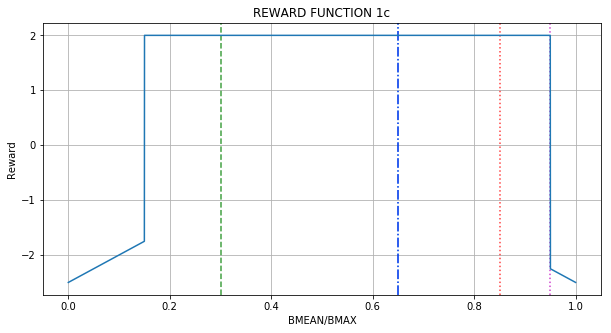

RF_1c(0)            =  -2.50
RF_1c(ENP_MARGIN/4) =  -2.50
RF_1c(ENP_MARGIN/2) =  -2.50
RF_1c(ENP_MARGIN)   =  -2.50

RF_1c(BMAX/2) =  -2.50
RF_1c(BMAX)   =  -2.50



In [15]:
#PLOT REWARD FUNCTIONS
x = np.arange(0,capm.BMAX)
y = [capm.rewardfn() for capm.btrack in x]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title('REWARD FUNCTION 1c')
ax.set_xlabel('BMEAN/BMAX')
ax.set_ylabel('Reward')
ax.axvline((capm.ENP_MARGIN)/capm.BMAX, color='g',alpha=0.75, linestyle='--')
ax.axvline(1-(capm.BSAFE_LO)/capm.BMAX, color='c',alpha=0.75, linestyle='-.')
ax.axvline(  (capm.BSAFE_HI)/capm.BMAX, color='b',alpha=0.75, linestyle="-.")
ax.axvline(1- (capm.BLIM_LO)/capm.BMAX, color='r',alpha=0.75, linestyle=':')
ax.axvline(   (capm.BLIM_HI)/capm.BMAX, color='m',alpha=0.75, linestyle=":")
ax.plot(x/capm.BMAX,y)
ax.grid(True)
plt.show()

capm.enp = 0;            print("RF_1c(0)            = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/4; print("RF_1c(ENP_MARGIN/4) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN/2; print("RF_1c(ENP_MARGIN/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.ENP_MARGIN;   print("RF_1c(ENP_MARGIN)   = {:6.2f}".format(capm.rewardfn()) )
print("");
capm.enp = capm.BMAX/2; print("RF_1c(BMAX/2) = {:6.2f}".format(capm.rewardfn()) )
capm.enp = capm.BMAX;   print("RF_1c(BMAX)   = {:6.2f}".format(capm.rewardfn()) )
print("");

In [16]:
#TRAINING STARTS
tic = datetime.now()

Device:  cpu

Iteration 0:  TOKYO, 2003 
EPSILON = 5.000e-01
LR = 3.392e-05
Average Terminal Reward  =  0.747
Day Violations           =    134
Battery Limit Violations =    426
Action MEAN              =  2.953
Action STD DEV           =  1.893


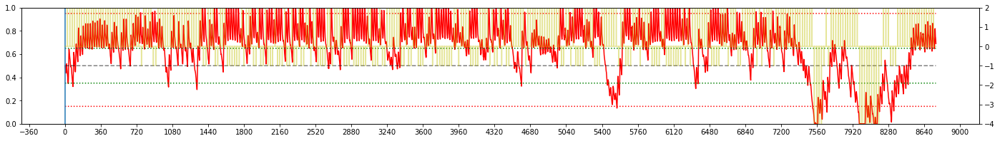


Iteration 1:  TOKYO, 2007 
EPSILON = 5.000e-01
LR = 4.174e-05
Average Terminal Reward  =  0.820
Day Violations           =    139
Battery Limit Violations =    454
Action MEAN              =  3.138
Action STD DEV           =  1.977


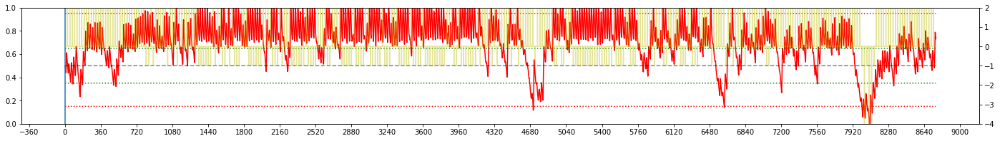


Iteration 2:  TOKYO, 2001 
EPSILON = 5.000e-01
LR = 5.000e-05
Average Terminal Reward  =  0.625
Day Violations           =    159
Battery Limit Violations =    477
Action MEAN              =  3.037
Action STD DEV           =  1.951


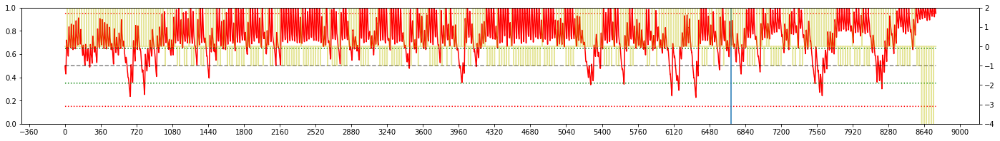


Iteration 3:  TOKYO, 2002 
EPSILON = 5.000e-01
LR = 5.826e-05
Average Terminal Reward  =  0.261
Day Violations           =    163
Battery Limit Violations =    834
Action MEAN              =  3.235
Action STD DEV           =  2.001


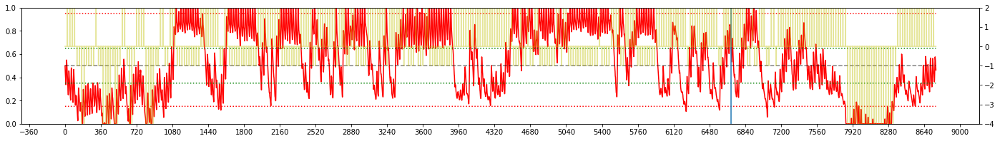


Iteration 4:  TOKYO, 2000 
EPSILON = 5.001e-01
LR = 6.608e-05
Average Terminal Reward  =  0.854
Day Violations           =    132
Battery Limit Violations =    562
Action MEAN              =  2.905
Action STD DEV           =  1.799


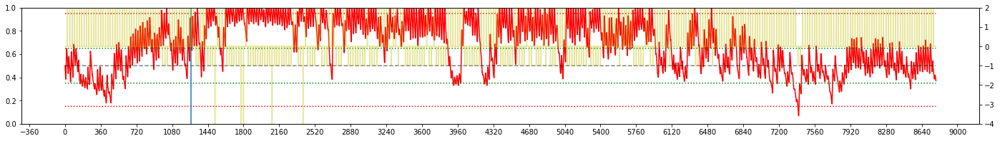


Iteration 5:  TOKYO, 2004 
EPSILON = 5.001e-01
LR = 7.311e-05
Average Terminal Reward  =  0.907
Day Violations           =    126
Battery Limit Violations =    458
Action MEAN              =  3.254
Action STD DEV           =  1.860


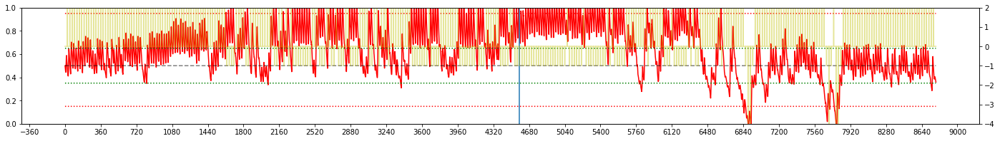


Iteration 6:  TOKYO, 2003 
EPSILON = 5.001e-01
LR = 7.914e-05
Average Terminal Reward  =  0.706
Day Violations           =     97
Battery Limit Violations =    617
Action MEAN              =  3.266
Action STD DEV           =  2.188


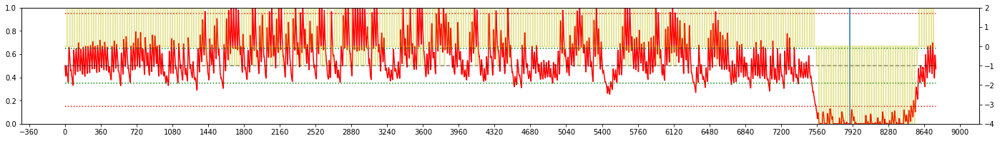


Iteration 7:  TOKYO, 2006 
EPSILON = 5.001e-01
LR = 8.411e-05
Average Terminal Reward  =  1.629
Day Violations           =     36
Battery Limit Violations =    122
Action MEAN              =  3.084
Action STD DEV           =  2.256


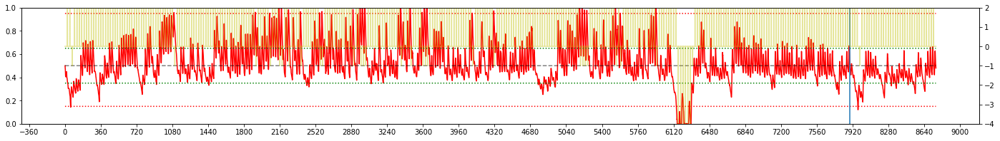


Iteration 8:  TOKYO, 2003 
EPSILON = 5.001e-01
LR = 8.808e-05
Average Terminal Reward  =  1.014
Day Violations           =     64
Battery Limit Violations =    529
Action MEAN              =  3.508
Action STD DEV           =  2.501


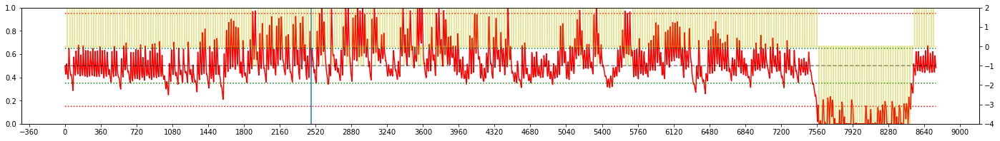


Iteration 9:  TOKYO, 2006 
EPSILON = 5.001e-01
LR = 9.116e-05
Average Terminal Reward  =  1.945
Day Violations           =      6
Battery Limit Violations =      1
Action MEAN              =  3.044
Action STD DEV           =  2.455


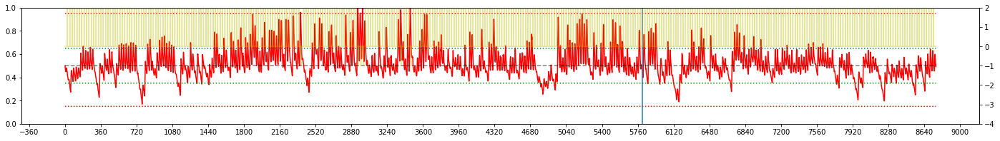


Iteration 10:  TOKYO, 2008 
EPSILON = 5.002e-01
LR = 9.350e-05
Average Terminal Reward  =  1.754
Day Violations           =     15
Battery Limit Violations =    170
Action MEAN              =  3.518
Action STD DEV           =  2.843


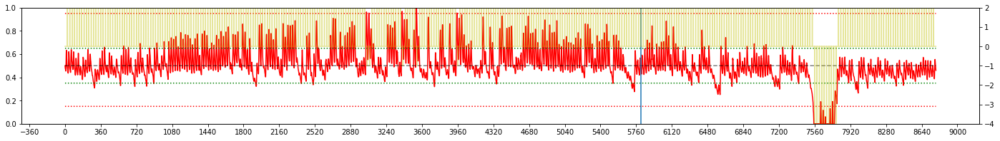


Iteration 11:  TOKYO, 2007 
EPSILON = 5.002e-01
LR = 9.526e-05
Average Terminal Reward  =  1.986
Day Violations           =      1
Battery Limit Violations =      0
Action MEAN              =  3.481
Action STD DEV           =  2.845


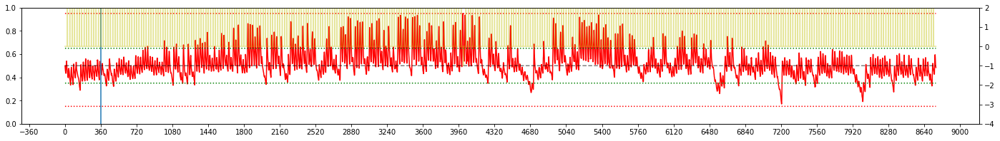


Iteration 12:  TOKYO, 2000 
EPSILON = 5.003e-01
LR = 9.656e-05
Average Terminal Reward  =  1.941
Day Violations           =      4
Battery Limit Violations =      1
Action MEAN              =  3.377
Action STD DEV           =  2.828


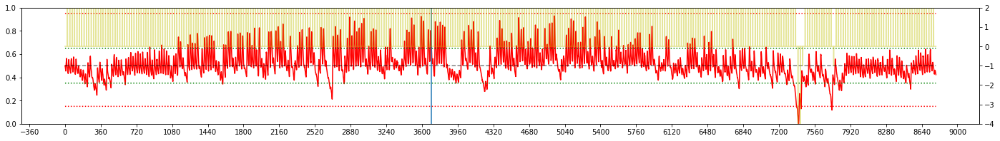


Iteration 13:  TOKYO, 2002 
EPSILON = 5.003e-01
LR = 9.751e-05
Average Terminal Reward  =  1.854
Day Violations           =      9
Battery Limit Violations =     47
Action MEAN              =  3.436
Action STD DEV           =  2.938


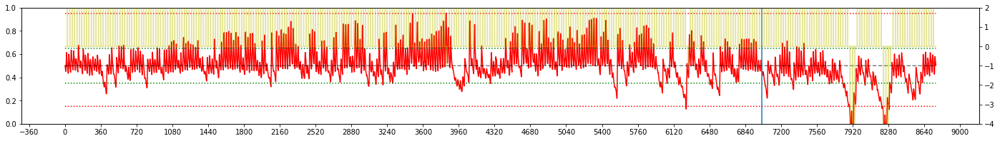


Iteration 14:  TOKYO, 2002 
EPSILON = 5.004e-01
LR = 9.820e-05
Average Terminal Reward  =  1.799
Day Violations           =     17
Battery Limit Violations =     51
Action MEAN              =  3.416
Action STD DEV           =  2.790


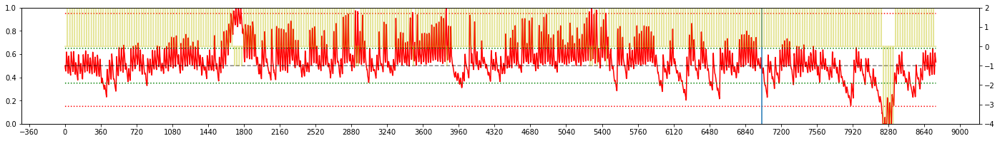


Iteration 15:  TOKYO, 2001 
EPSILON = 5.005e-01
LR = 9.870e-05
Average Terminal Reward  =  1.822
Day Violations           =     21
Battery Limit Violations =      5
Action MEAN              =  3.391
Action STD DEV           =  2.652


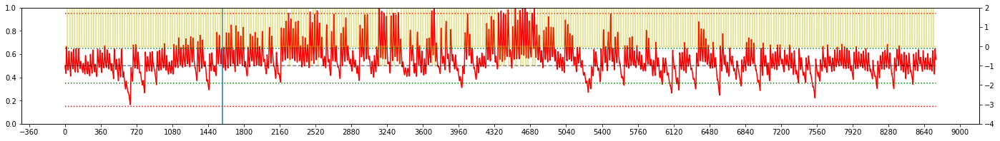


Iteration 16:  TOKYO, 2003 
EPSILON = 5.006e-01
LR = 9.907e-05
Average Terminal Reward  =  1.901
Day Violations           =     10
Battery Limit Violations =     10
Action MEAN              =  3.159
Action STD DEV           =  2.624


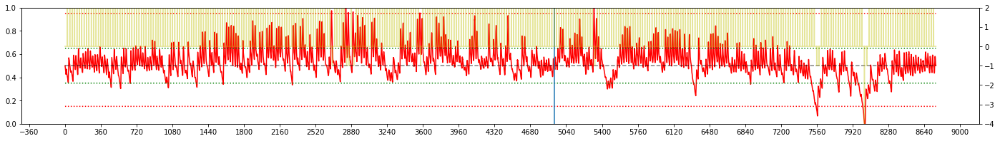


Iteration 17:  TOKYO, 2000 
EPSILON = 5.007e-01
LR = 9.933e-05
Average Terminal Reward  =  1.880
Day Violations           =     14
Battery Limit Violations =      6
Action MEAN              =  3.377
Action STD DEV           =  2.774


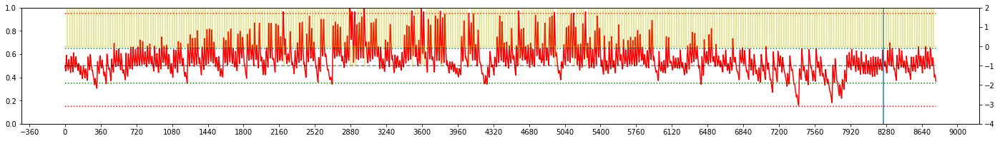


Iteration 18:  TOKYO, 2003 
EPSILON = 5.008e-01
LR = 9.952e-05
Average Terminal Reward  =  1.870
Day Violations           =     10
Battery Limit Violations =     21
Action MEAN              =  3.165
Action STD DEV           =  2.615


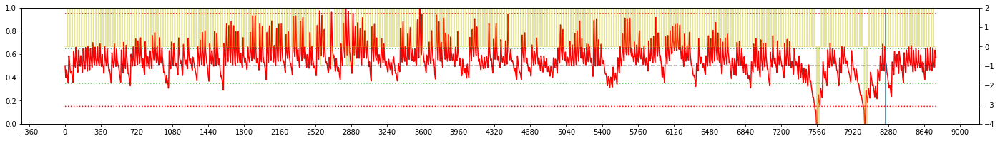


Iteration 19:  TOKYO, 2009 
EPSILON = 5.010e-01
LR = 9.966e-05
Average Terminal Reward  =  1.805
Day Violations           =     23
Battery Limit Violations =     15
Action MEAN              =  3.311
Action STD DEV           =  2.696


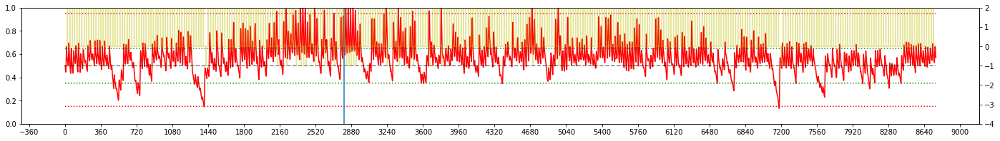


Iteration 20:  TOKYO, 2004 
EPSILON = 5.012e-01
LR = 9.975e-05
Average Terminal Reward  =  1.732
Day Violations           =     32
Battery Limit Violations =     56
Action MEAN              =  3.566
Action STD DEV           =  2.862


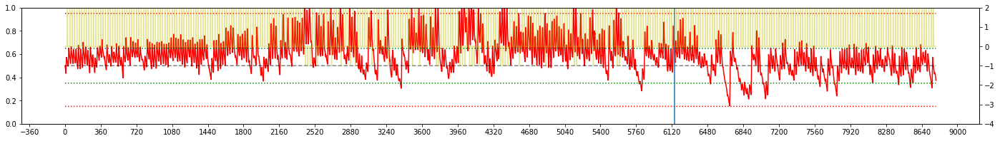


Iteration 21:  TOKYO, 2000 
EPSILON = 5.015e-01
LR = 9.982e-05
Average Terminal Reward  =  1.804
Day Violations           =     22
Battery Limit Violations =     23
Action MEAN              =  3.375
Action STD DEV           =  2.746


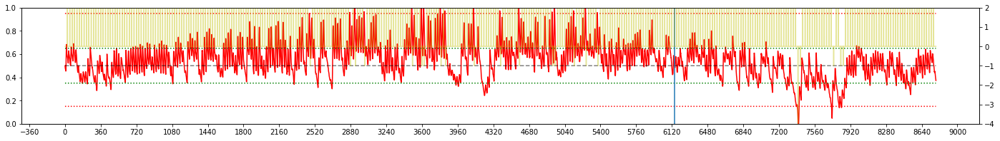


Iteration 22:  TOKYO, 2003 
EPSILON = 5.018e-01
LR = 9.987e-05
Average Terminal Reward  =  1.893
Day Violations           =      7
Battery Limit Violations =     39
Action MEAN              =  3.172
Action STD DEV           =  2.620


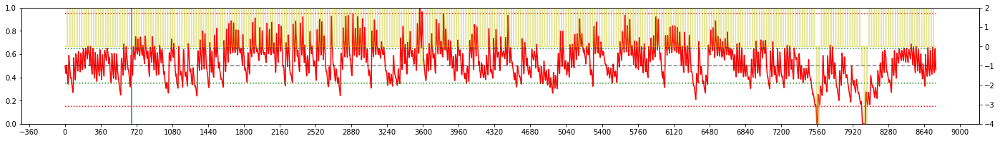


Iteration 23:  TOKYO, 2002 
EPSILON = 5.022e-01
LR = 9.991e-05
Average Terminal Reward  =  1.681
Day Violations           =     34
Battery Limit Violations =     31
Action MEAN              =  3.398
Action STD DEV           =  2.791


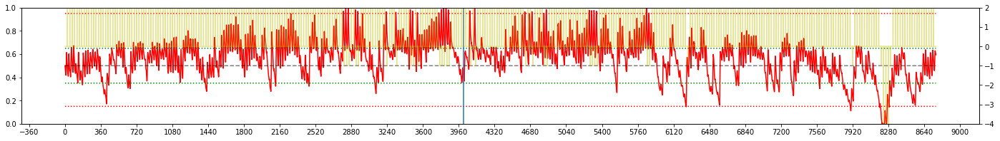


Iteration 24:  TOKYO, 2005 
EPSILON = 5.027e-01
LR = 9.993e-05
Average Terminal Reward  =  1.871
Day Violations           =     15
Battery Limit Violations =     17
Action MEAN              =  3.400
Action STD DEV           =  2.778


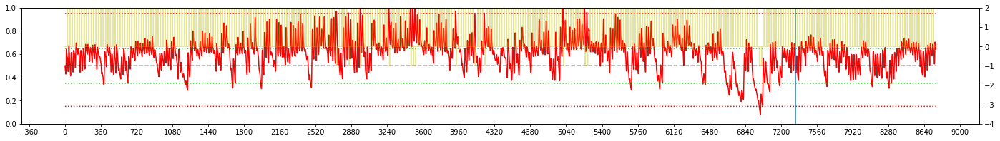


Iteration 25:  TOKYO, 2005 
EPSILON = 5.033e-01
LR = 9.995e-05
Average Terminal Reward  =  1.764
Day Violations           =     28
Battery Limit Violations =     34
Action MEAN              =  3.393
Action STD DEV           =  2.743


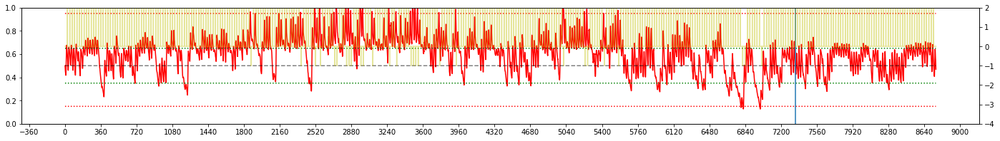


Iteration 26:  TOKYO, 2005 
EPSILON = 5.041e-01
LR = 9.997e-05
Average Terminal Reward  =  1.863
Day Violations           =     16
Battery Limit Violations =      5
Action MEAN              =  3.410
Action STD DEV           =  2.669


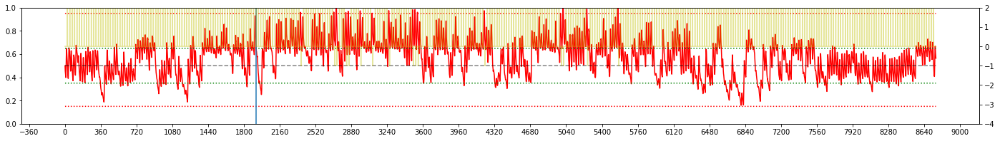


Iteration 27:  TOKYO, 2008 
EPSILON = 5.050e-01
LR = 9.998e-05
Average Terminal Reward  =  1.954
Day Violations           =      5
Battery Limit Violations =      2
Action MEAN              =  3.360
Action STD DEV           =  2.515


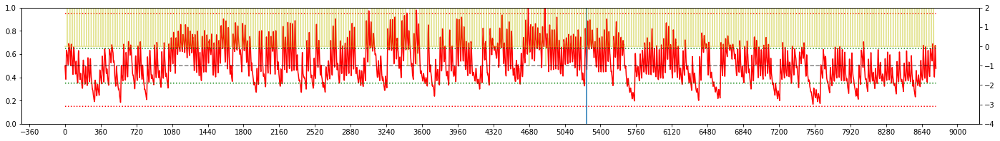


Iteration 28:  TOKYO, 2009 
EPSILON = 5.061e-01
LR = 9.998e-05
Average Terminal Reward  =  1.869
Day Violations           =     14
Battery Limit Violations =      3
Action MEAN              =  3.318
Action STD DEV           =  2.500


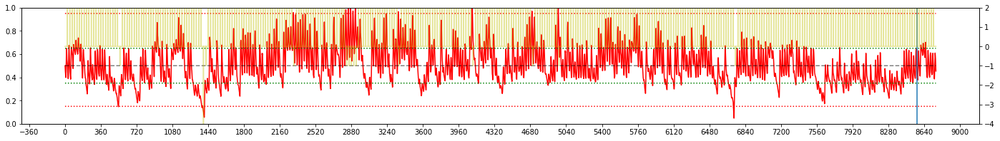


Iteration 29:  TOKYO, 2003 
EPSILON = 5.074e-01
LR = 9.999e-05
Average Terminal Reward  =  1.838
Day Violations           =     12
Battery Limit Violations =     86
Action MEAN              =  3.230
Action STD DEV           =  2.482


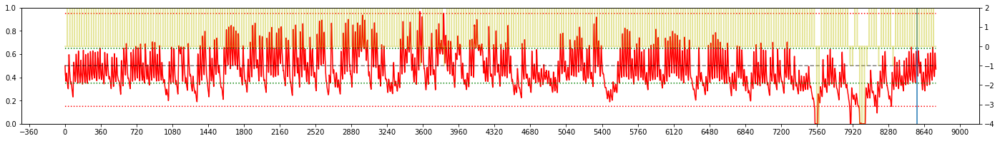


Iteration 30:  TOKYO, 2009 
EPSILON = 5.090e-01
LR = 9.999e-05
Average Terminal Reward  =  1.803
Day Violations           =     22
Battery Limit Violations =     22
Action MEAN              =  3.315
Action STD DEV           =  2.443


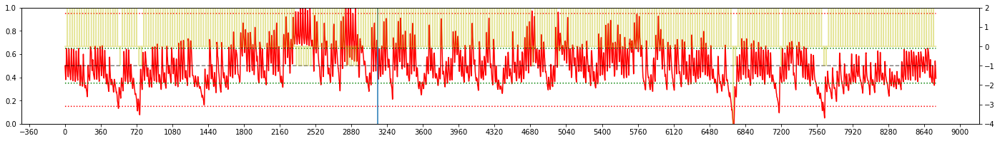


Iteration 31:  TOKYO, 2005 
EPSILON = 5.109e-01
LR = 9.999e-05
Average Terminal Reward  =  1.817
Day Violations           =     19
Battery Limit Violations =     12
Action MEAN              =  3.407
Action STD DEV           =  2.647


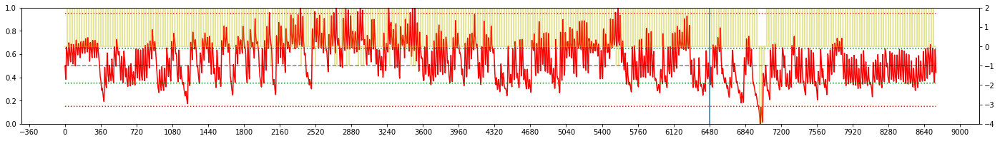


Iteration 32:  TOKYO, 2006 
EPSILON = 5.133e-01
LR = 1.000e-04
Average Terminal Reward  =  1.719
Day Violations           =     25
Battery Limit Violations =     96
Action MEAN              =  3.067
Action STD DEV           =  2.408


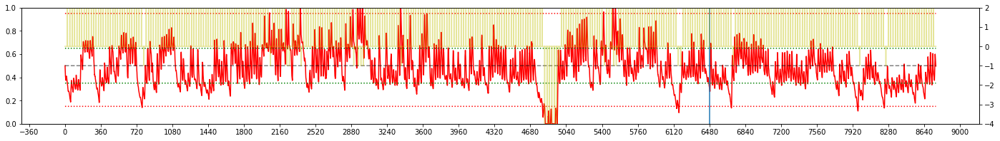


Iteration 33:  TOKYO, 2008 
EPSILON = 5.161e-01
LR = 1.000e-04
Average Terminal Reward  =  1.698
Day Violations           =     29
Battery Limit Violations =     74
Action MEAN              =  3.399
Action STD DEV           =  2.556


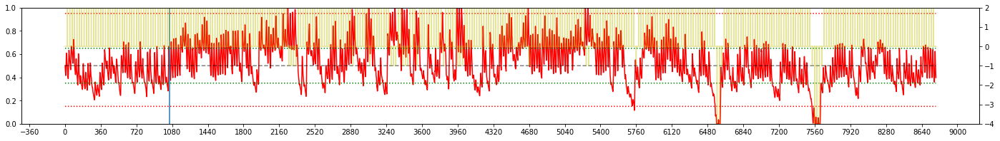


Iteration 34:  TOKYO, 2007 
EPSILON = 5.196e-01
LR = 1.000e-04
Average Terminal Reward  =  1.715
Day Violations           =     34
Battery Limit Violations =     38
Action MEAN              =  3.459
Action STD DEV           =  2.702


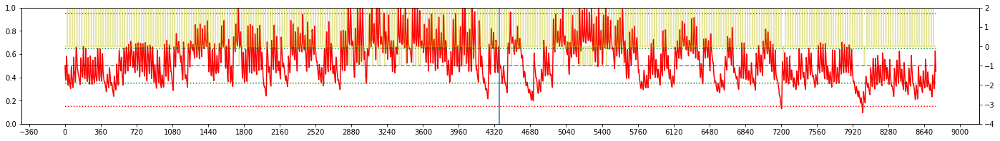


Iteration 35:  TOKYO, 2002 
EPSILON = 5.237e-01
LR = 1.000e-04
Average Terminal Reward  =  1.751
Day Violations           =     27
Battery Limit Violations =     11
Action MEAN              =  3.397
Action STD DEV           =  2.482


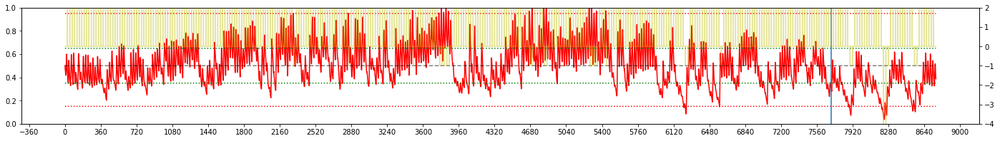


Iteration 36:  TOKYO, 2007 
EPSILON = 5.287e-01
LR = 1.000e-04
Average Terminal Reward  =  1.879
Day Violations           =     14
Battery Limit Violations =      6
Action MEAN              =  3.477
Action STD DEV           =  2.402


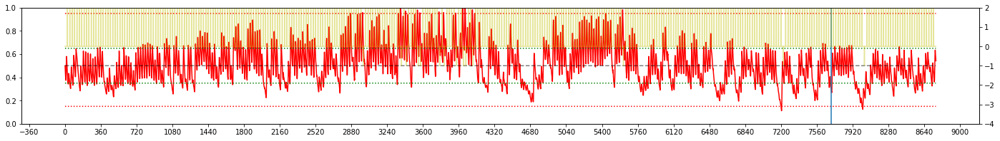


Iteration 37:  TOKYO, 2000 
EPSILON = 5.346e-01
LR = 1.000e-04
Average Terminal Reward  =  1.831
Day Violations           =     16
Battery Limit Violations =     23
Action MEAN              =  3.392
Action STD DEV           =  2.477


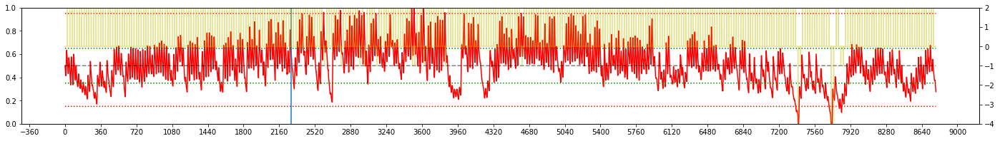


Iteration 38:  TOKYO, 2007 
EPSILON = 5.416e-01
LR = 1.000e-04
Average Terminal Reward  =  1.871
Day Violations           =     15
Battery Limit Violations =      4
Action MEAN              =  3.479
Action STD DEV           =  2.710


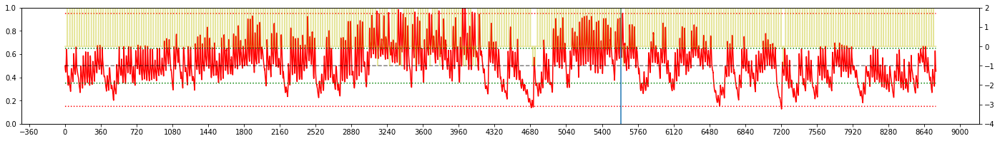


Iteration 39:  TOKYO, 2009 
EPSILON = 5.499e-01
LR = 1.000e-04
Average Terminal Reward  =  1.802
Day Violations           =     22
Battery Limit Violations =     24
Action MEAN              =  3.334
Action STD DEV           =  2.648


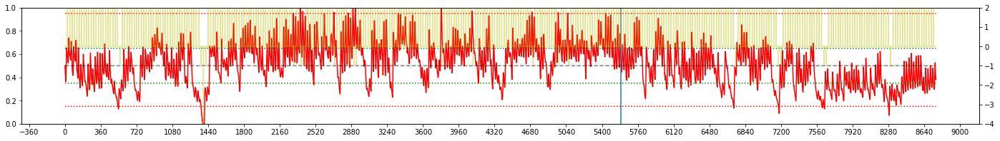


Iteration 40:  TOKYO, 2005 
EPSILON = 5.596e-01
LR = 1.000e-04
Average Terminal Reward  =  1.829
Day Violations           =     16
Battery Limit Violations =     39
Action MEAN              =  3.430
Action STD DEV           =  2.577


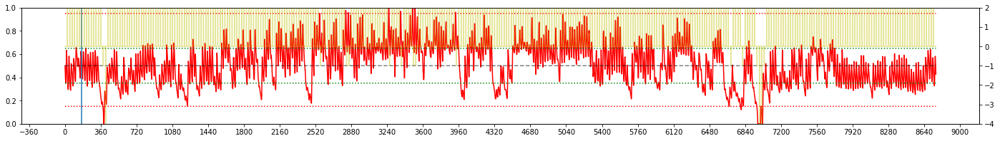


Iteration 41:  TOKYO, 2008 
EPSILON = 5.709e-01
LR = 1.000e-04
Average Terminal Reward  =  1.894
Day Violations           =     11
Battery Limit Violations =      0
Action MEAN              =  3.358
Action STD DEV           =  2.444


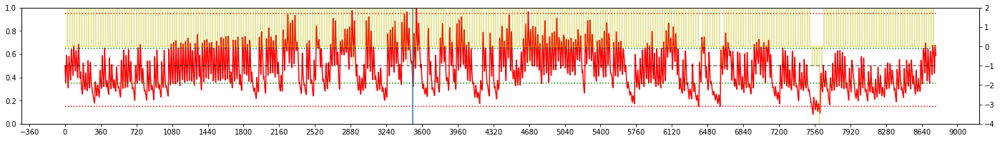


Iteration 42:  TOKYO, 2003 
EPSILON = 5.840e-01
LR = 1.000e-04
Average Terminal Reward  =  1.810
Day Violations           =     17
Battery Limit Violations =     44
Action MEAN              =  3.199
Action STD DEV           =  2.470


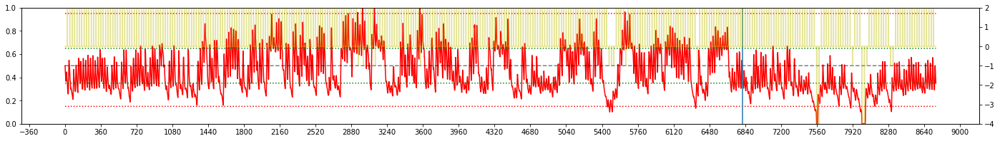


Iteration 43:  TOKYO, 2005 
EPSILON = 5.989e-01
LR = 1.000e-04
Average Terminal Reward  =  1.758
Day Violations           =     22
Battery Limit Violations =     53
Action MEAN              =  3.435
Action STD DEV           =  2.551


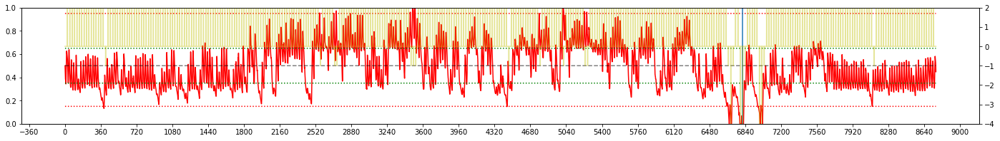


Iteration 44:  TOKYO, 2008 
EPSILON = 6.157e-01
LR = 1.000e-04
Average Terminal Reward  =  1.816
Day Violations           =     16
Battery Limit Violations =     65
Action MEAN              =  3.406
Action STD DEV           =  2.553


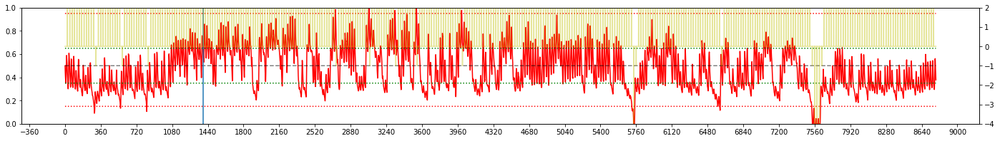


Iteration 45:  TOKYO, 2000 
EPSILON = 6.345e-01
LR = 1.000e-04
Average Terminal Reward  =  1.762
Day Violations           =     27
Battery Limit Violations =     27
Action MEAN              =  3.381
Action STD DEV           =  2.628


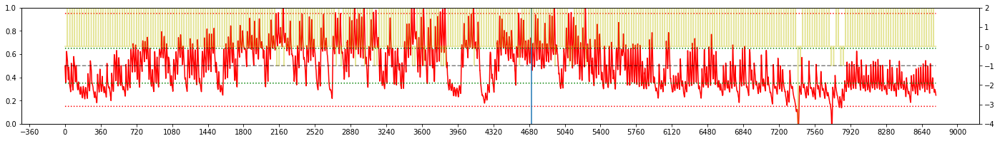


Iteration 46:  TOKYO, 2001 
EPSILON = 6.550e-01
LR = 1.000e-04
Average Terminal Reward  =  1.879
Day Violations           =     14
Battery Limit Violations =     12
Action MEAN              =  3.389
Action STD DEV           =  2.529


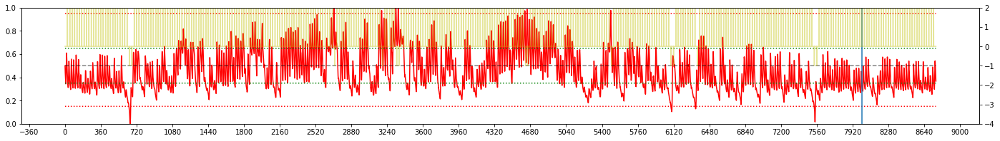


Iteration 47:  TOKYO, 2007 
EPSILON = 6.772e-01
LR = 1.000e-04
Average Terminal Reward  =  1.896
Day Violations           =     12
Battery Limit Violations =      2
Action MEAN              =  3.482
Action STD DEV           =  2.525


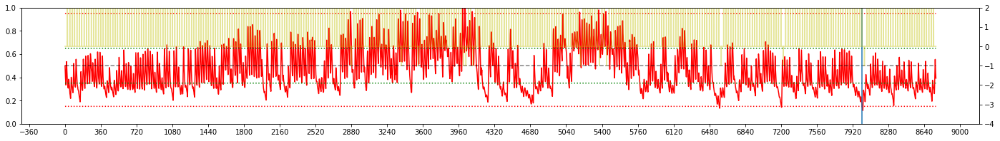


Iteration 48:  TOKYO, 2006 
EPSILON = 7.007e-01
LR = 1.000e-04
Average Terminal Reward  =  1.891
Day Violations           =     10
Battery Limit Violations =      3
Action MEAN              =  3.049
Action STD DEV           =  2.391


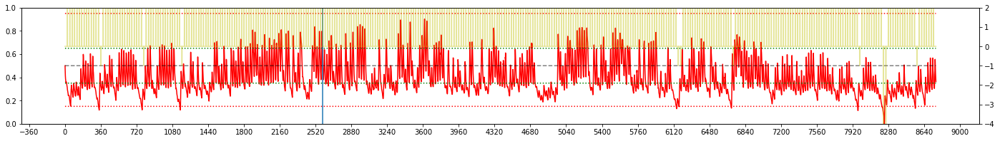


Iteration 49:  TOKYO, 2009 
EPSILON = 7.251e-01
LR = 1.000e-04
Average Terminal Reward  =  1.783
Day Violations           =     23
Battery Limit Violations =     26
Action MEAN              =  3.328
Action STD DEV           =  2.637


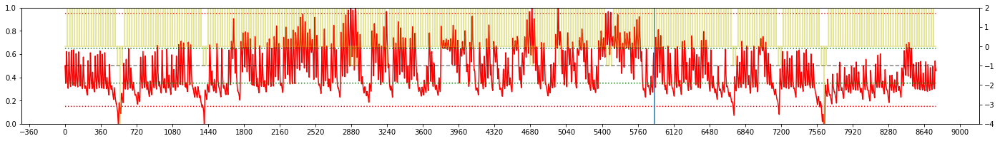


Iteration 50:  TOKYO, 2007 
EPSILON = 7.500e-01
LR = 1.000e-04
Average Terminal Reward  =  1.797
Day Violations           =     24
Battery Limit Violations =     44
Action MEAN              =  3.463
Action STD DEV           =  2.698


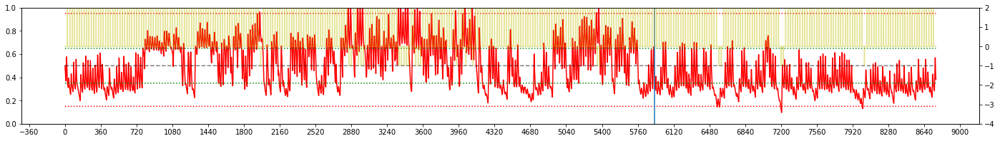


Iteration 51:  TOKYO, 2008 
EPSILON = 7.749e-01
LR = 8.750e-05
Average Terminal Reward  =  1.820
Day Violations           =     17
Battery Limit Violations =     43
Action MEAN              =  3.392
Action STD DEV           =  2.651


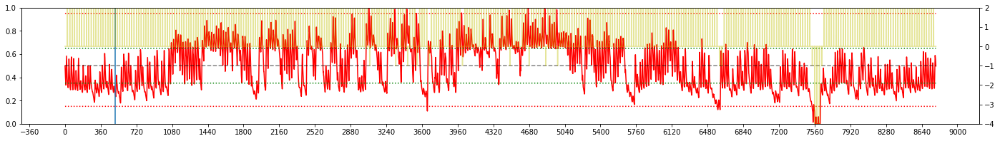


Iteration 52:  TOKYO, 2001 
EPSILON = 7.993e-01
LR = 7.681e-05
Average Terminal Reward  =  1.781
Day Violations           =     26
Battery Limit Violations =     22
Action MEAN              =  3.392
Action STD DEV           =  2.465


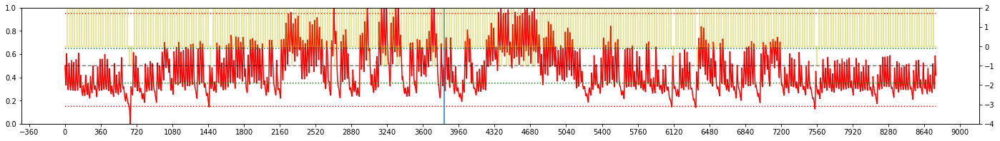


Iteration 53:  TOKYO, 2001 
EPSILON = 8.228e-01
LR = 6.767e-05
Average Terminal Reward  =  1.912
Day Violations           =     10
Battery Limit Violations =      4
Action MEAN              =  3.397
Action STD DEV           =  2.710


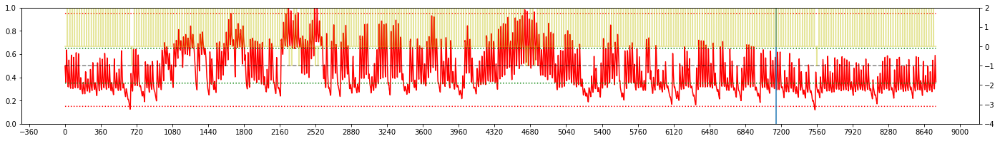


Iteration 54:  TOKYO, 2002 
EPSILON = 8.450e-01
LR = 5.986e-05
Average Terminal Reward  =  1.844
Day Violations           =     13
Battery Limit Violations =     24
Action MEAN              =  3.422
Action STD DEV           =  2.684


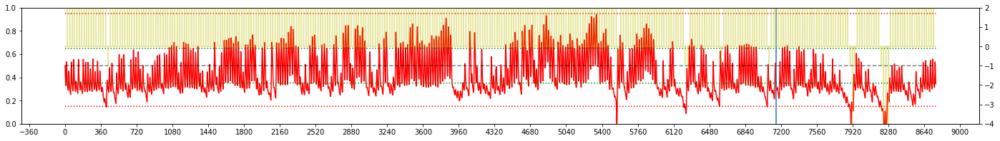


Iteration 55:  TOKYO, 2004 
EPSILON = 8.655e-01
LR = 5.318e-05
Average Terminal Reward  =  1.863
Day Violations           =     16
Battery Limit Violations =      5
Action MEAN              =  3.596
Action STD DEV           =  2.620


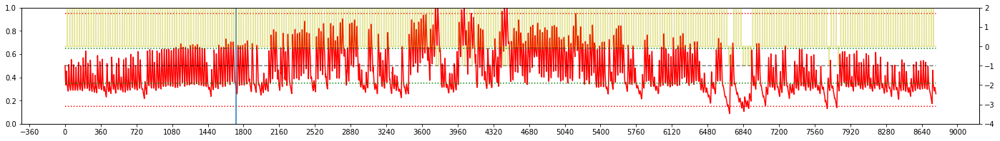


Iteration 56:  TOKYO, 2007 
EPSILON = 8.843e-01
LR = 4.747e-05
Average Terminal Reward  =  1.970
Day Violations           =      3
Battery Limit Violations =      1
Action MEAN              =  3.483
Action STD DEV           =  2.633


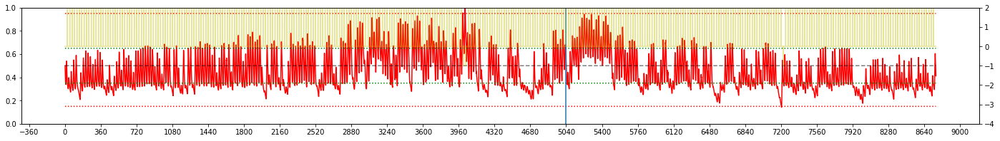


Iteration 57:  TOKYO, 2008 
EPSILON = 9.011e-01
LR = 4.259e-05
Average Terminal Reward  =  1.986
Day Violations           =      1
Battery Limit Violations =      0
Action MEAN              =  3.362
Action STD DEV           =  2.530


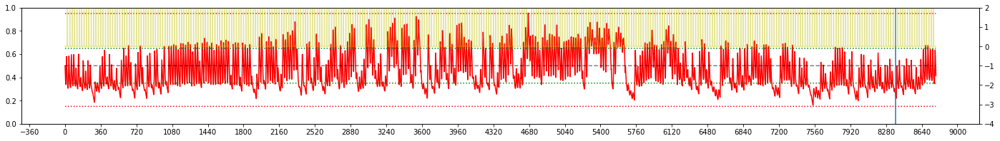


Iteration 58:  TOKYO, 2006 
EPSILON = 9.160e-01
LR = 3.841e-05
Average Terminal Reward  =  1.962
Day Violations           =      4
Battery Limit Violations =      0
Action MEAN              =  3.047
Action STD DEV           =  2.490


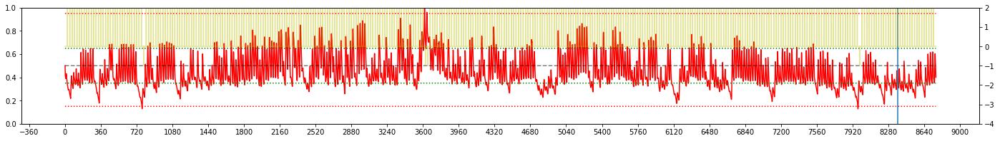


Iteration 59:  TOKYO, 2006 
EPSILON = 9.291e-01
LR = 3.484e-05
Average Terminal Reward  =  1.986
Day Violations           =      1
Battery Limit Violations =      0
Action MEAN              =  3.047
Action STD DEV           =  2.414


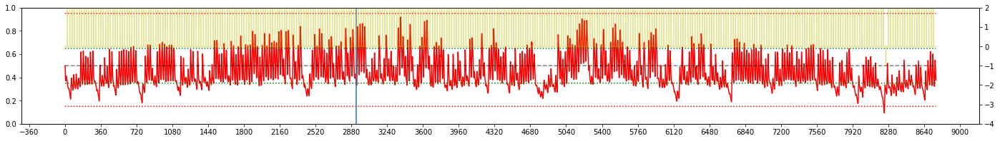


Iteration 60:  TOKYO, 2005 
EPSILON = 9.404e-01
LR = 3.179e-05
Average Terminal Reward  =  1.986
Day Violations           =      1
Battery Limit Violations =      0
Action MEAN              =  3.417
Action STD DEV           =  2.517


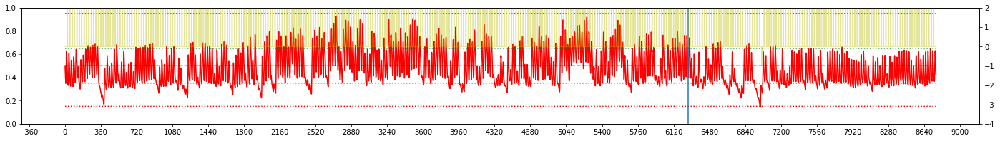


Iteration 61:  TOKYO, 2009 
EPSILON = 9.501e-01
LR = 2.918e-05
Average Terminal Reward  =  1.921
Day Violations           =      9
Battery Limit Violations =      1
Action MEAN              =  3.320
Action STD DEV           =  2.497


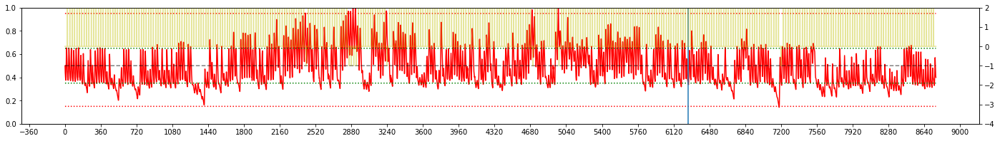


Iteration 62:  TOKYO, 2006 
EPSILON = 9.584e-01
LR = 2.695e-05
Average Terminal Reward  =  1.888
Day Violations           =     13
Battery Limit Violations =      3
Action MEAN              =  3.046
Action STD DEV           =  2.569


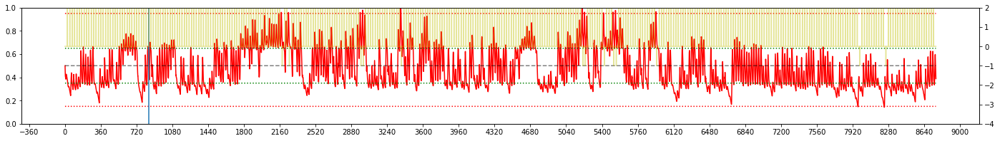


Iteration 63:  TOKYO, 2003 
EPSILON = 9.654e-01
LR = 2.504e-05
Average Terminal Reward  =  1.934
Day Violations           =      6
Battery Limit Violations =     12
Action MEAN              =  3.170
Action STD DEV           =  2.437


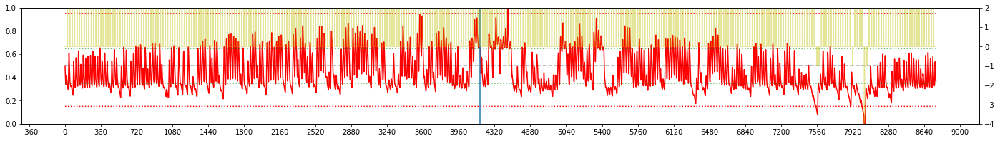


Iteration 64:  TOKYO, 2004 
EPSILON = 9.713e-01
LR = 2.341e-05
Average Terminal Reward  =  1.880
Day Violations           =     14
Battery Limit Violations =      8
Action MEAN              =  3.591
Action STD DEV           =  2.813


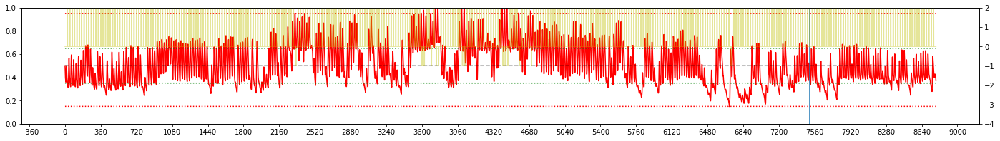


Iteration 65:  TOKYO, 2001 
EPSILON = 9.763e-01
LR = 2.202e-05
Average Terminal Reward  =  1.953
Day Violations           =      5
Battery Limit Violations =      1
Action MEAN              =  3.396
Action STD DEV           =  2.524


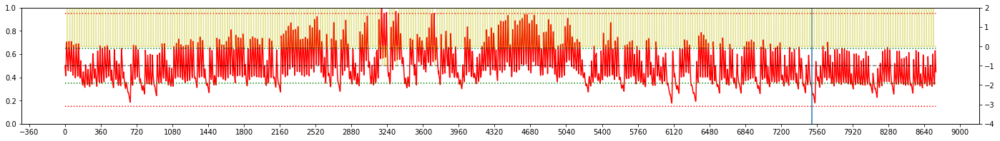


Iteration 66:  TOKYO, 2000 
EPSILON = 9.804e-01
LR = 2.082e-05
Average Terminal Reward  =  1.986
Day Violations           =      1
Battery Limit Violations =      0
Action MEAN              =  3.378
Action STD DEV           =  2.617


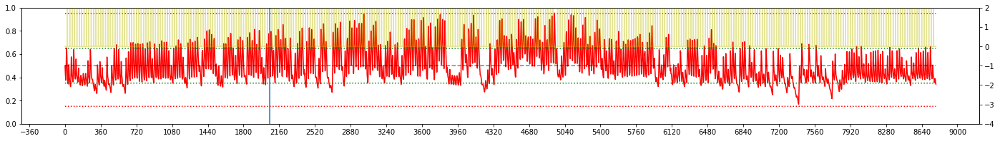


Iteration 67:  TOKYO, 2003 
EPSILON = 9.839e-01
LR = 1.980e-05
Average Terminal Reward  =  1.978
Day Violations           =      2
Battery Limit Violations =      0
Action MEAN              =  3.158
Action STD DEV           =  2.382


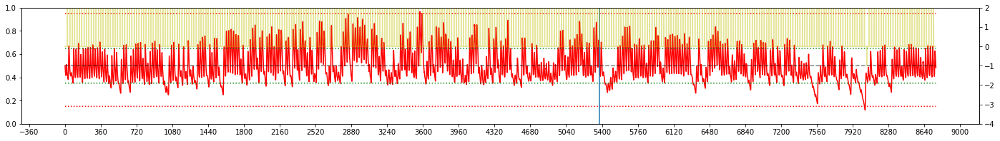


Iteration 68:  TOKYO, 2003 
EPSILON = 9.867e-01
LR = 1.893e-05
Average Terminal Reward  =  1.953
Day Violations           =      5
Battery Limit Violations =      0
Action MEAN              =  3.159
Action STD DEV           =  2.397


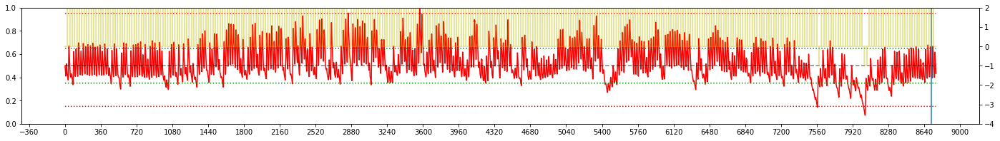


Iteration 69:  TOKYO, 2000 
EPSILON = 9.891e-01
LR = 1.819e-05
Average Terminal Reward  =  1.921
Day Violations           =      9
Battery Limit Violations =      0
Action MEAN              =  3.377
Action STD DEV           =  2.617


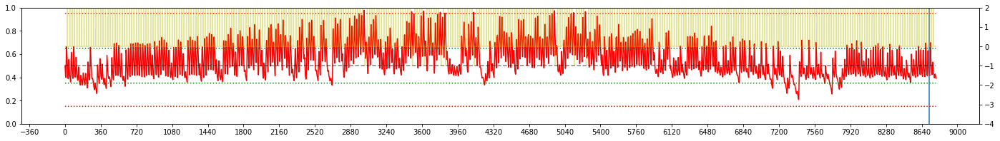


Iteration 70:  TOKYO, 2009 
EPSILON = 9.910e-01
LR = 1.755e-05
Average Terminal Reward  =  1.921
Day Violations           =      9
Battery Limit Violations =      2
Action MEAN              =  3.318
Action STD DEV           =  2.776


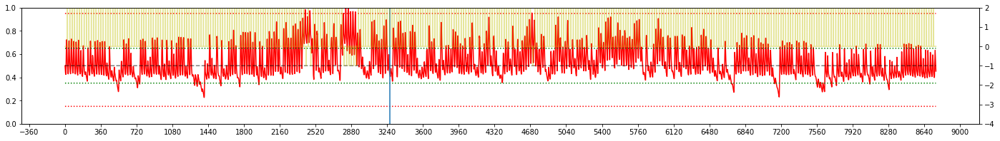


Iteration 71:  TOKYO, 2007 
EPSILON = 9.926e-01
LR = 1.701e-05
Average Terminal Reward  =  1.953
Day Violations           =      5
Battery Limit Violations =      4
Action MEAN              =  3.478
Action STD DEV           =  2.708


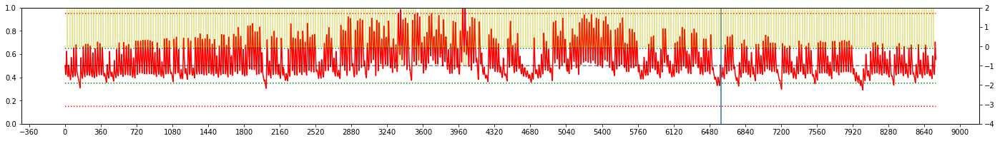


Iteration 72:  TOKYO, 2004 
EPSILON = 9.939e-01
LR = 1.654e-05
Average Terminal Reward  =  1.913
Day Violations           =     10
Battery Limit Violations =      7
Action MEAN              =  3.592
Action STD DEV           =  2.637


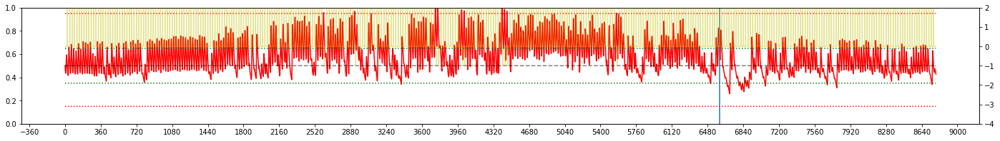


Iteration 73:  TOKYO, 2003 
EPSILON = 9.950e-01
LR = 1.614e-05
Average Terminal Reward  =  1.978
Day Violations           =      2
Battery Limit Violations =      2
Action MEAN              =  3.156
Action STD DEV           =  2.414


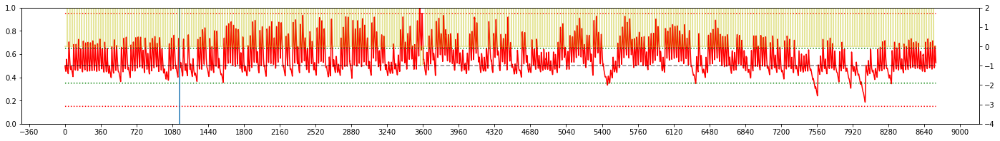


Iteration 74:  TOKYO, 2005 
EPSILON = 9.959e-01
LR = 1.580e-05
Average Terminal Reward  =  1.929
Day Violations           =      8
Battery Limit Violations =      6
Action MEAN              =  3.412
Action STD DEV           =  2.428


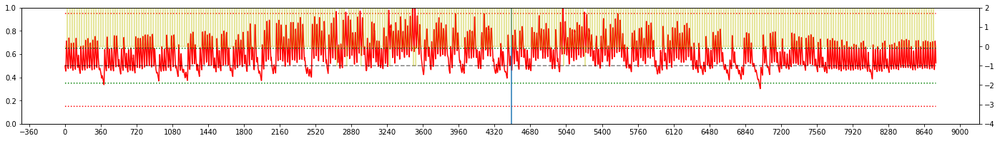


Iteration 75:  TOKYO, 2000 
EPSILON = 9.967e-01
LR = 1.551e-05
Average Terminal Reward  =  1.872
Day Violations           =     15
Battery Limit Violations =     17
Action MEAN              =  3.368
Action STD DEV           =  2.610


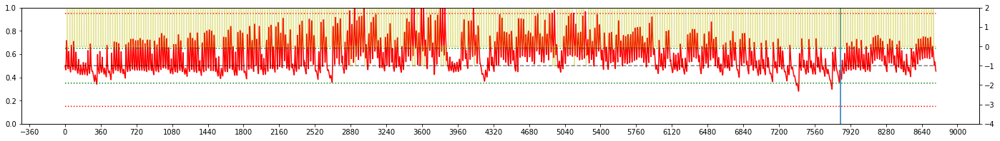


Iteration 76:  TOKYO, 2006 
EPSILON = 9.973e-01
LR = 1.526e-05
Average Terminal Reward  =  1.945
Day Violations           =      6
Battery Limit Violations =      1
Action MEAN              =  3.045
Action STD DEV           =  2.436


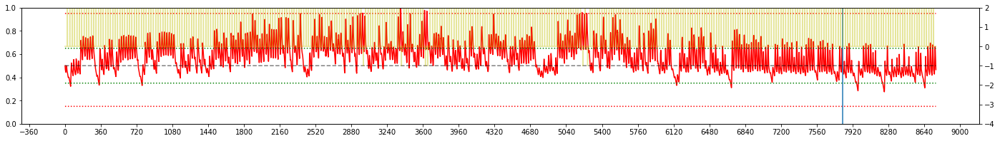


Iteration 77:  TOKYO, 2001 
EPSILON = 9.978e-01
LR = 1.505e-05
Average Terminal Reward  =  1.978
Day Violations           =      2
Battery Limit Violations =      0
Action MEAN              =  3.391
Action STD DEV           =  2.654


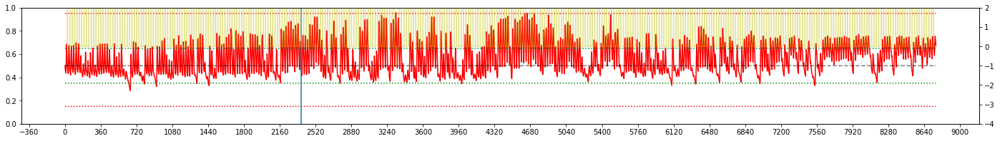


Iteration 78:  TOKYO, 2007 
EPSILON = 9.982e-01
LR = 1.487e-05
Average Terminal Reward  =  1.748
Day Violations           =     30
Battery Limit Violations =     14
Action MEAN              =  3.473
Action STD DEV           =  2.768


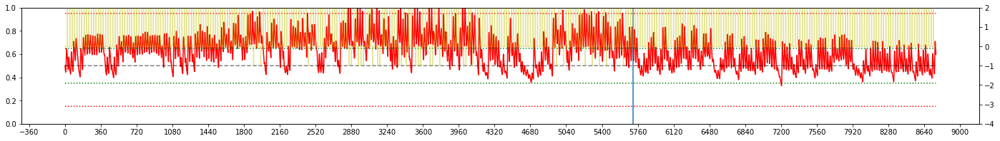


Iteration 79:  TOKYO, 2004 
EPSILON = 9.985e-01
LR = 1.471e-05
Average Terminal Reward  =  1.863
Day Violations           =     16
Battery Limit Violations =      8
Action MEAN              =  3.590
Action STD DEV           =  2.714


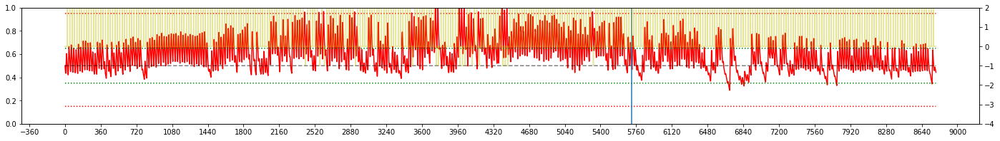


Iteration 80:  TOKYO, 2005 
EPSILON = 9.988e-01
LR = 1.458e-05
Average Terminal Reward  =  1.912
Day Violations           =     10
Battery Limit Violations =      2
Action MEAN              =  3.412
Action STD DEV           =  2.527


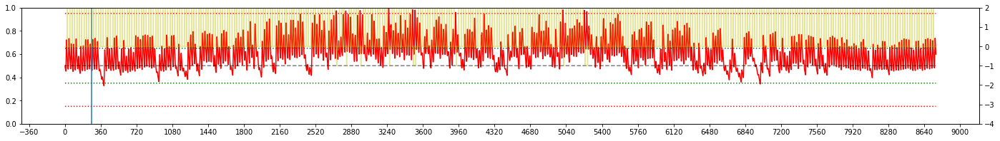


Iteration 81:  TOKYO, 2005 
EPSILON = 9.990e-01
LR = 1.446e-05
Average Terminal Reward  =  1.896
Day Violations           =     12
Battery Limit Violations =      1
Action MEAN              =  3.411
Action STD DEV           =  2.550


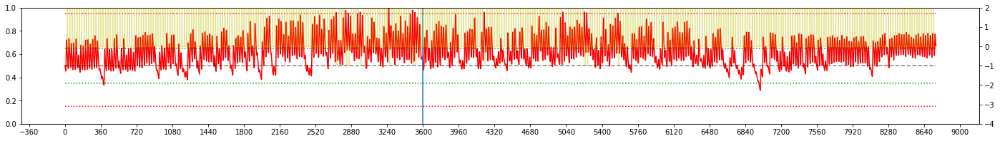


Iteration 82:  TOKYO, 2001 
EPSILON = 9.992e-01
LR = 1.437e-05
Average Terminal Reward  =  1.756
Day Violations           =     29
Battery Limit Violations =      3
Action MEAN              =  3.391
Action STD DEV           =  2.615


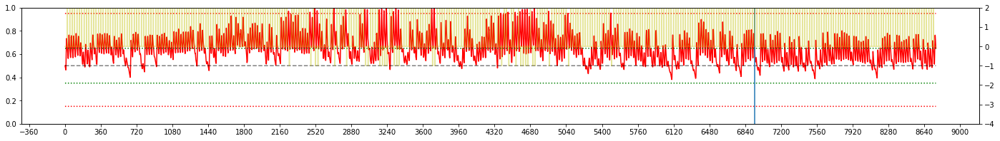


Iteration 83:  TOKYO, 2006 
EPSILON = 9.993e-01
LR = 1.428e-05
Average Terminal Reward  =  1.855
Day Violations           =     17
Battery Limit Violations =     13
Action MEAN              =  3.038
Action STD DEV           =  2.359


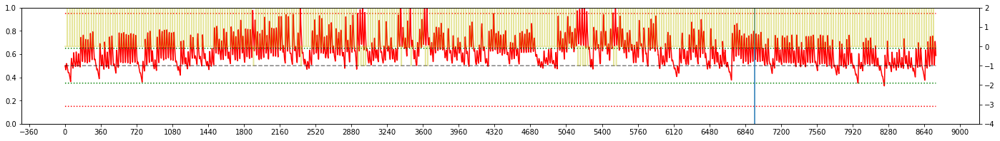


Iteration 84:  TOKYO, 2009 
EPSILON = 9.994e-01
LR = 1.421e-05
Average Terminal Reward  =  1.814
Day Violations           =     22
Battery Limit Violations =     20
Action MEAN              =  3.309
Action STD DEV           =  2.467


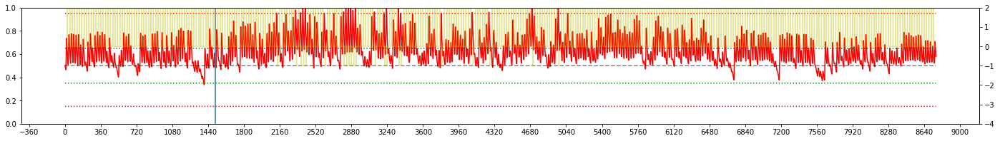


Iteration 85:  TOKYO, 2003 
EPSILON = 9.995e-01
LR = 1.415e-05
Average Terminal Reward  =  1.912
Day Violations           =     10
Battery Limit Violations =      4
Action MEAN              =  3.154
Action STD DEV           =  2.541


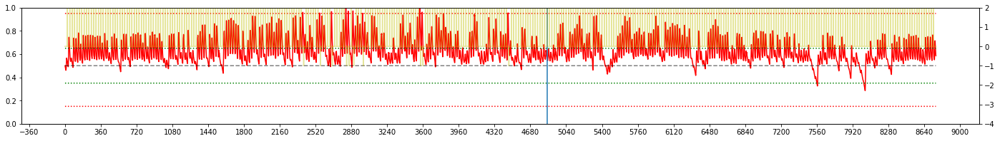


Iteration 86:  TOKYO, 2003 
EPSILON = 9.996e-01
LR = 1.410e-05
Average Terminal Reward  =  1.929
Day Violations           =      8
Battery Limit Violations =      2
Action MEAN              =  3.155
Action STD DEV           =  2.598


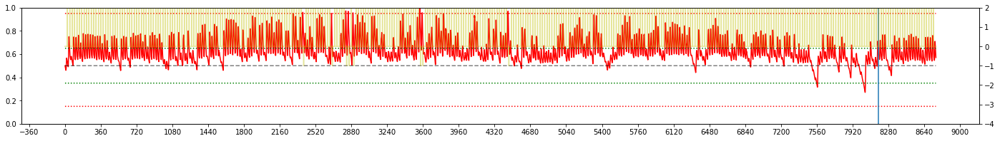


Iteration 87:  TOKYO, 2000 
EPSILON = 9.997e-01
LR = 1.406e-05
Average Terminal Reward  =  1.847
Day Violations           =     18
Battery Limit Violations =      3
Action MEAN              =  3.373
Action STD DEV           =  2.751


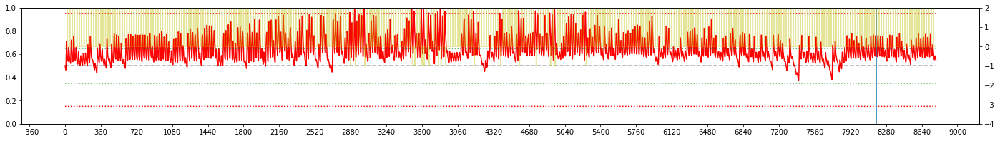


Iteration 88:  TOKYO, 2005 
EPSILON = 9.997e-01
LR = 1.402e-05
Average Terminal Reward  =  1.904
Day Violations           =     11
Battery Limit Violations =      2
Action MEAN              =  3.412
Action STD DEV           =  2.770


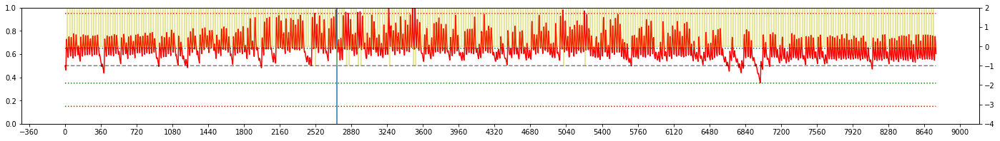


Iteration 89:  TOKYO, 2009 
EPSILON = 9.998e-01
LR = 1.398e-05
Average Terminal Reward  =  1.855
Day Violations           =     17
Battery Limit Violations =      4
Action MEAN              =  3.314
Action STD DEV           =  2.649


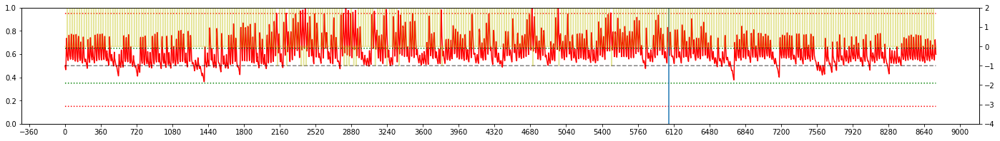


Iteration 90:  TOKYO, 2007 
EPSILON = 9.998e-01
LR = 1.396e-05
Average Terminal Reward  =  1.789
Day Violations           =     25
Battery Limit Violations =     13
Action MEAN              =  3.473
Action STD DEV           =  2.816


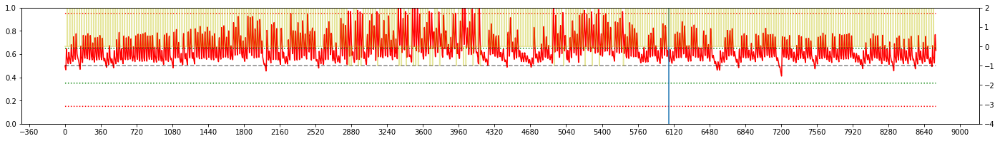


Iteration 91:  TOKYO, 2005 
EPSILON = 9.999e-01
LR = 1.393e-05
Average Terminal Reward  =  1.904
Day Violations           =     11
Battery Limit Violations =      2
Action MEAN              =  3.412
Action STD DEV           =  2.763


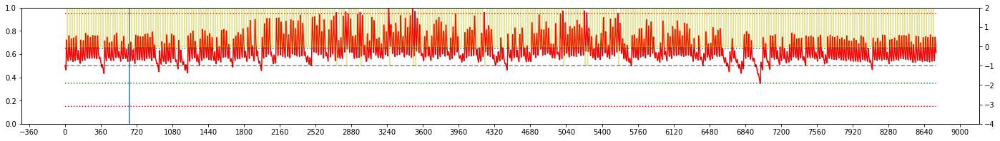


Iteration 92:  TOKYO, 2004 
EPSILON = 9.999e-01
LR = 1.391e-05
Average Terminal Reward  =  1.806
Day Violations           =     23
Battery Limit Violations =     10
Action MEAN              =  3.589
Action STD DEV           =  2.837


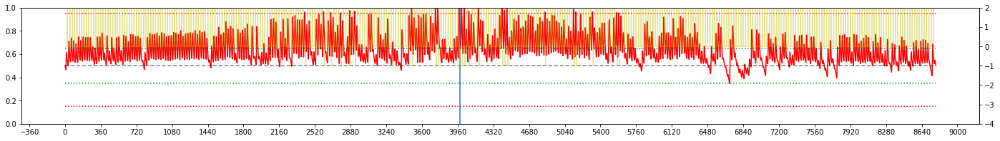


Iteration 93:  TOKYO, 2001 
EPSILON = 9.999e-01
LR = 1.390e-05
Average Terminal Reward  =  1.781
Day Violations           =     26
Battery Limit Violations =      3
Action MEAN              =  3.392
Action STD DEV           =  2.698


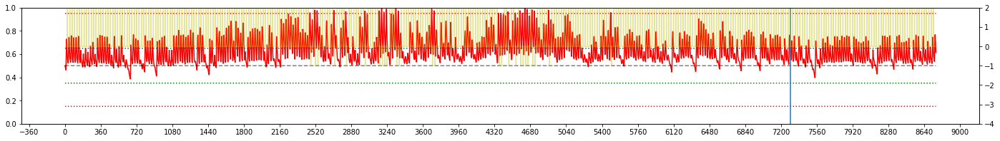


Iteration 94:  TOKYO, 2000 
EPSILON = 9.999e-01
LR = 1.388e-05
Average Terminal Reward  =  1.855
Day Violations           =     17
Battery Limit Violations =      0
Action MEAN              =  3.375
Action STD DEV           =  2.702


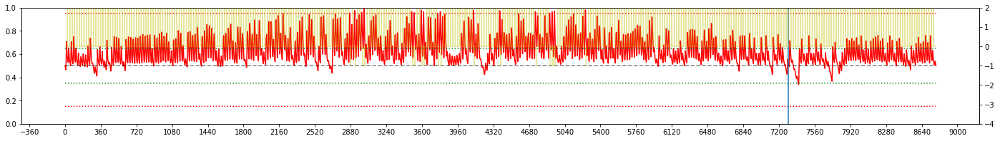


Iteration 95:  TOKYO, 2008 
EPSILON = 9.999e-01
LR = 1.387e-05
Average Terminal Reward  =  1.904
Day Violations           =     11
Battery Limit Violations =      2
Action MEAN              =  3.357
Action STD DEV           =  2.575


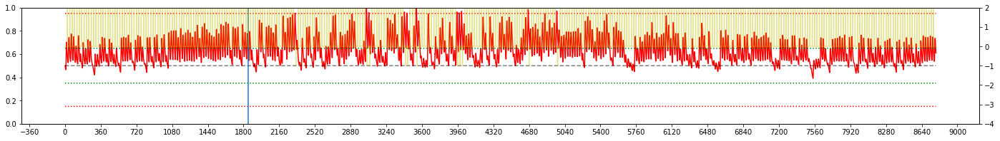


Iteration 96:  TOKYO, 2005 
EPSILON = 9.999e-01
LR = 1.386e-05
Average Terminal Reward  =  1.921
Day Violations           =      9
Battery Limit Violations =      6
Action MEAN              =  3.410
Action STD DEV           =  2.531


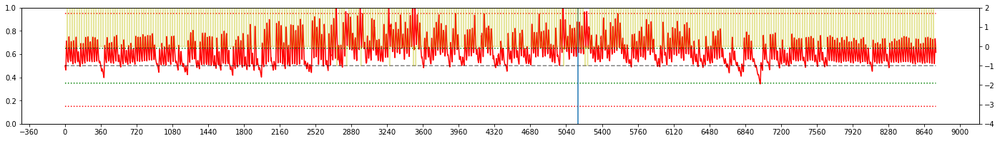


Iteration 97:  TOKYO, 2006 
EPSILON = 1.000e+00
LR = 1.385e-05
Average Terminal Reward  =  1.888
Day Violations           =     13
Battery Limit Violations =      6
Action MEAN              =  3.040
Action STD DEV           =  2.342


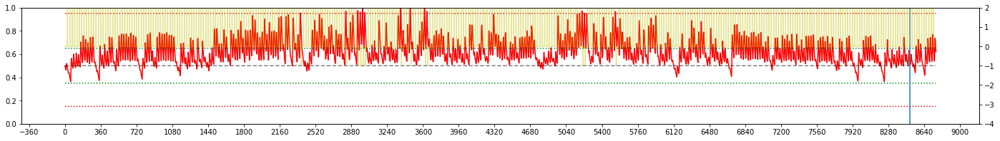


Iteration 98:  TOKYO, 2002 
EPSILON = 1.000e+00
LR = 1.384e-05
Average Terminal Reward  =  1.773
Day Violations           =     27
Battery Limit Violations =     23
Action MEAN              =  3.388
Action STD DEV           =  2.683


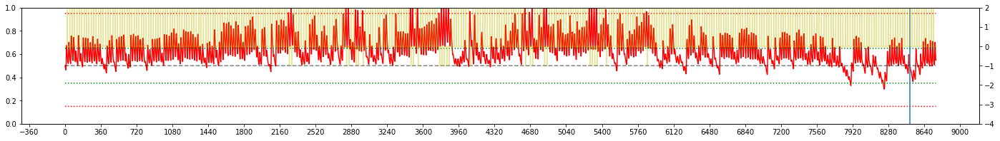


Iteration 99:  TOKYO, 2000 
EPSILON = 1.000e+00
LR = 1.383e-05
Average Terminal Reward  =  1.822
Day Violations           =     21
Battery Limit Violations =     18
Action MEAN              =  3.370
Action STD DEV           =  2.579


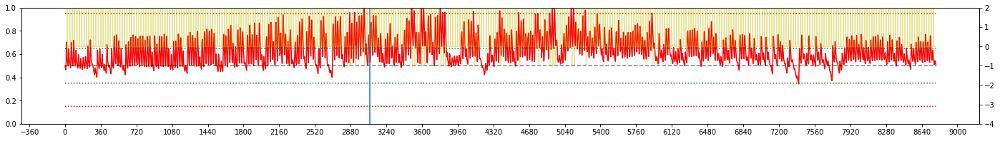

In [17]:
#TRAIN 
dqn = DQN()
# for recording weights
oldfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
old2fc1 = oldfc1

# oldfc2 = dqn.eval_net.fc2.weight.data.cpu().numpy().flatten()
# old2fc2 = oldfc2

# oldfc3 = dqn.eval_net.fc3.weight.data.cpu().numpy().flatten()
# old2fc3 = oldfc3

oldout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
old2out = oldout
########################################

change_hr = 0 #when dqn target_net is updated by eval_net
avg_reward_rec = [] #record the yearly average rewards over the entire duration of training
batt_violation_rec = []
day_violation_rec = []

print('Device: ', dqn.device)
#TRAINING STARTS
tic = datetime.now()

e_rec = []
lr_rec = []
for iteration in range(NO_OF_ITERATIONS):
    # EPSILON SCHEDULING
    e_slope = 5
    e_start = 0.5
    e_inflection_point = 50
    EPSILON = e_start + (1-e_start)/(1 + np.exp(-(iteration-e_inflection_point)/e_slope))

    # LR SCEHDULING
    lr_slope = 3
    lr_start = 0
    lr_inflection_point = 2
    if iteration <=50:
        lrate =  (lr_start + (1-lr_start)/(1 + np.exp(-(iteration-lr_inflection_point)/lr_slope)))*1e-4
    else:
        lrate = 0.95*(lrate-lrate*0.1)+0.2*1e-5
    dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate)
#     dqn.optimizer = torch.optim.Adam(dqn.eval_net.parameters(), lr=lrate, weight_decay=WT_DECAY))
    lr_rec= np.append(lr_rec,lrate)

    LOCATION    = 'tokyo'#random.choice(['tokyo','wakkanai','minamidaito'])
    YEAR        = random.choice(np.arange(2000,2010))
    
    capm        = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
    capm.eno    = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
    capm.HMAX   = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object


    s, r, day_end, year_end = capm.reset()
    yr_record      = np.empty(4)
    transition_rec = np.zeros((capm.eno.TIME_STEPS, N_STATES * 2 + 2)) #record all the transition in one day

    while True:
        a = dqn.choose_action(stdize(s))
        yr_record = np.vstack((yr_record, [s[0],s[2],r, a]))

        # take action
        s_, r, day_end, year_end = capm.step(a)
        
        temp_transitions                = np.hstack((stdize(s), [a, r], stdize(s_)))
        transition_rec[capm.eno.hr-1,:] = temp_transitions

        if (day_end):
            transition_rec[:,5]  = r #broadcast reward to all states
            decay_factor         = [i for i in (LAMBDA**n for n in reversed(range(0, capm.eno.TIME_STEPS)))]
            transition_rec[:,5]  = transition_rec[:,5] * decay_factor #decay reward proportionately
            dqn.store_day_transition(transition_rec)

        if dqn.memory_counter > MEMORY_CAPACITY:
            dqn.learn()

        if dqn.nettoggle:
            change_hr = capm.eno.day*24+capm.eno.hr #to mark when the DQN is updated.
            dqn.nettoggle = not dqn.nettoggle

        if (year_end):
            break

        # transition to new state
        s = s_

    yr_record = np.delete(yr_record, 0, 0)     #remove the first row which is garbage
    hourly_yr_reward_rec = yr_record[:,2]      #extract reward information from the record array
    yr_reward_rec = hourly_yr_reward_rec[::24] #only consider terminal rewards

    print('\nIteration {}:  {}, {} '.format(iteration, LOCATION.upper(), YEAR))
    print('EPSILON = {:6.3e}'.format(EPSILON))
    for param_group in dqn.optimizer.param_groups:
        print('LR = {:6.3e}'.format(param_group['lr']))
    print("Average Terminal Reward  = {:6.3f}".format(np.mean(yr_reward_rec)))
    print("Day Violations           = {:6d}".format(capm.violation_counter))
    print("Battery Limit Violations = {:6d}".format(capm.batt_violations))
    print("Action MEAN              = {:6.3f}".format(np.mean(yr_record[:,-1] + 1)))
    print("Action STD DEV           = {:6.3f}".format(np.std(yr_record[:,-1] + 1)))
   
    # Log the average reward in avg_reward_rec to plot later in the learning curve graph figure
    avg_reward_rec      = np.append(avg_reward_rec, np.mean(yr_reward_rec))
    day_violation_rec   = np.append(day_violation_rec, capm.violation_counter)
    batt_violation_rec  = np.append(batt_violation_rec, capm.batt_violations)

###########################################################################################
###########################################################################################
#   PLOT battery levels, hourly rewards and the weights
    
    #PLOT BATTERY AND REWARD
    fig = plt.figure(figsize=(24,3))
    TIME_STEPS = capm.eno.TIME_STEPS
    NO_OF_DAYS = capm.eno.NO_OF_DAYS
    DAY_SPACING = 15
    TICK_SPACING = TIME_STEPS*DAY_SPACING
    
    #plot battery
    ax = fig.add_subplot(111)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS),  yr_record[:,0],'r')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BOPT/capm.BMAX, 'k--', alpha=0.5)
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
    ax.plot(np.arange(0,TIME_STEPS*NO_OF_DAYS), np.ones_like(yr_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
    ax.set_ylim([0,1])
    ax.axvline(x=change_hr)
    ax.xaxis.set_major_locator(ticker.MultipleLocator(TICK_SPACING))

    #plot hourly reward
    ax0 = ax.twinx()
    ax0.plot(hourly_yr_reward_rec, color='y',alpha=0.4)
    ax0.set_ylim(-4,2)
    
    plt.show()
# # #################################################################
#     # PLOT WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
#     ax1.bar(xaxis, old2fc1, color='b', alpha = 0.3)
#     ax1.bar(xaxis, oldfc1,  color='b', alpha = 0.5)
#     ax1.bar(xaxis, newfc1,  color='b', alpha = 1.0)
#     ax1.set_title("FC1")
# #     ax1.set_ylim([-4,4])
#     ax1.set_ylabel("Weight Value")

#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
#     axO.bar(xaxis, old2out, color='g', alpha = 0.3)
#     axO.bar(xaxis, oldout,  color='g', alpha = 0.5)
#     axO.bar(xaxis, newout,  color='g', alpha = 1.0)
#     axO.set_title("FC OUT")
# #     axO.set_ylim([-4,4])
#     axO.set_ylabel("Weight Value")

#     fig.tight_layout()
#     plt.show()
# # #################################################################

#     # PLOT HISTOGRAM OF WEIGHTS
#     fig = plt.figure(figsize=(18,6))

#     ax1 = fig.add_subplot(211)
#     newfc1 = dqn.eval_net.fc1.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newfc1.shape[0])
# #     ax1.hist(old2fc1, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.1 )
# #     ax1.hist(oldfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.3 )
#     ax1.hist(newfc1,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='b' , alpha = 0.6 )
#     ax1.set_title("FC1")
#     ax1.set_xlabel("Weight Value")


#     axO = fig.add_subplot(212)
#     newout = dqn.eval_net.fc_out.weight.data.cpu().numpy().flatten()
#     xaxis = np.arange(0,newout.shape[0])
# #     axO.hist(old2out, density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.1)
# #     axO.hist(oldout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.3)
#     axO.hist(newout,  density = False, bins=HIDDEN_LAYER, rwidth=0.95, color='g' , alpha = 0.6)
#     axO.set_title("FC OUT")
#     axO.set_xlabel("Weight Value")


#     fig.tight_layout()
#     plt.show()
# # #################################################################    
    
#     old2fc1 = oldfc1
#     oldfc1 = newfc1
    
#     old2out = oldout
#     oldout = newout

    # End of training

In [18]:
print('Train time: {}\n'.format(datetime.now() - tic))
torch.save(dqn.eval_net.state_dict(), './models/'+ 'demo_' + MODELNAME)

Train time: 0:31:16.696293



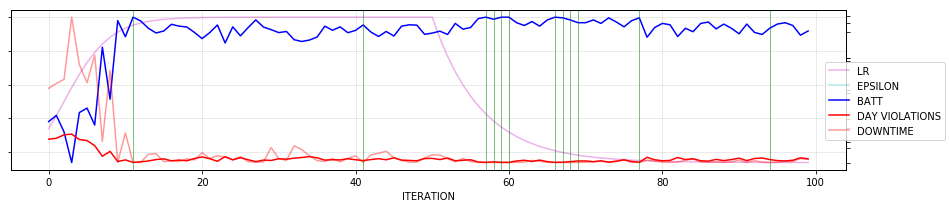

In [19]:
###########################################################################################
###########################################################################################

#PLOT LR AND EPSILON SCHEDULING
fig = plt.figure(figsize=(12,3))
ax = fig.add_subplot(111)
# ax.set_title("LR and EPSILON SCHEDULING V3")
ax.set_xlabel("ITERATION")
# ax.set_ylabel("LR",      color = 'm')
ax.plot(lr_rec,          color = 'm', alpha = 0.3,label="LR")
# ax.tick_params(axis='y', color = 'm')
# ax.ticklabel_format(style='sci', axis='y', scilimits=(-6,-7))
# ax.minorticks_on()

# ax.set_axisbelow(True)
ax.yaxis.set_ticklabels([])

ax.grid(b=True, which='minor', linestyle=':',  color='k', alpha = 0.1)
ax.grid(b=True, which='major', linestyle='-',  color='k', alpha = 0.1)

ax_ = ax.twinx()
# ax_.set_ylabel("EPSILON", color = 'c')
# ax_.tick_params(axis='y', color = 'c')
# ax_.set_axisbelow(True)
# ax_.minorticks_on()
ax_.plot(e_rec,           color = 'c', alpha = 0.3, label="EPSILON")
ax_.yaxis.set_ticklabels([])

# Plot the average reward log
ax1 = ax.twinx()
# ax1.set_ylabel("Terminal Reward", color = 'b')
# ax1.set_ylim([-10,2]);
ax1.plot(avg_reward_rec,'b',label="BATT")
# ax1.tick_params(axis='y', colors='b')
ax1.yaxis.set_ticklabels([])

# Plot the violation record log
ax2 = ax.twinx()
# ax2.set_ylabel("Violations",color = 'r')
ax2.plot(day_violation_rec,'r', label="DAY VIOLATIONS")
ax2.plot(batt_violation_rec,'r',alpha=0.4, label="DOWNTIME")
for xpt in np.argwhere(batt_violation_rec<1):
    ax2.axvline(x=xpt,color='g',linewidth='0.5')
# ax2.set_ylim([0,50]);
# ax2.tick_params(axis='y', colors='r')
ax2.yaxis.set_ticklabels([])

fig.legend(bbox_to_anchor=(1.1, 0.7))


fig.tight_layout()

###########################################################################################
###########################################################################################

In [20]:
# print("ITERATION #0 :  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[0],e_rec[0]))
# print("ITERATION #10:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[10],e_rec[10]))
# print("ITERATION #20:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[20],e_rec[20]))
# print("ITERATION #50:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[50],e_rec[50]))
# print("ITERATION #80:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[80],e_rec[80]))
# print("ITERATION #99:  LR = {:4.2e} @ EPSILON = {:4.2f}".format(lr_rec[99],e_rec[99]))

In [21]:
S_FILENAME = './models/'+ 'demo_'+ MODELNAME
# S_FILENAME = './models/'+ MODELNAME
print("Loading MODEL from FILE: ", S_FILENAME)
dqn = DQN()
dqn.eval_net.load_state_dict(torch.load(S_FILENAME))
dqn.eval_net.eval()
print("DEVICE: ", dqn.device)

Loading MODEL from FILE:  ./models/demo_B1_314.pt
DEVICE:  cpu


***MEASURING PERFORMANCE OF THE MODEL***


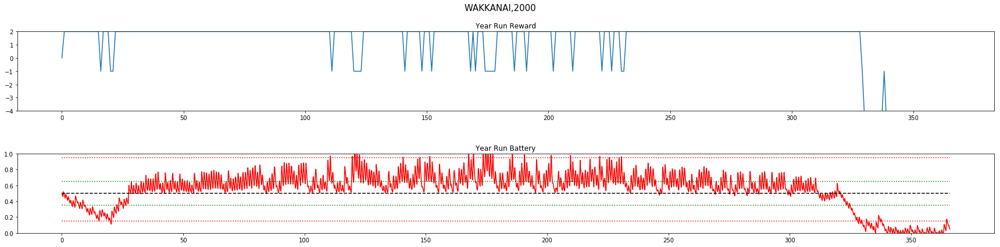

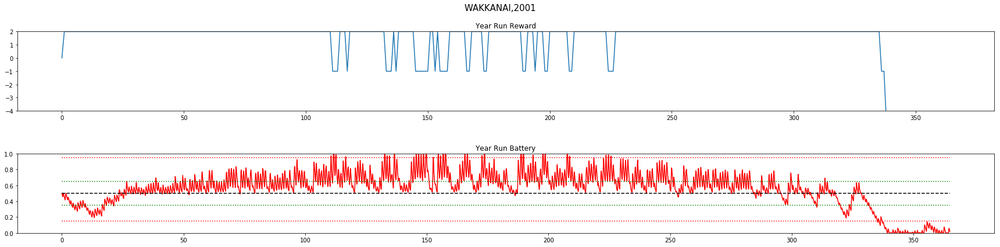

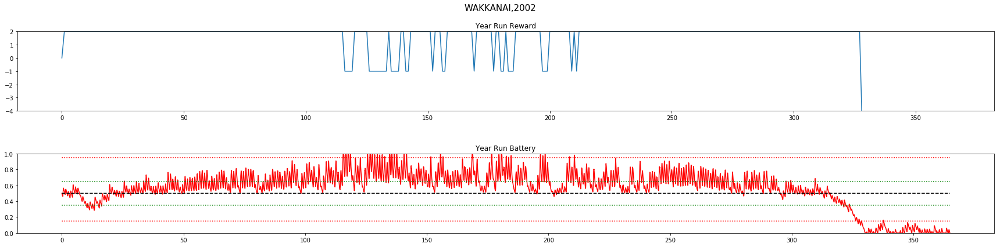

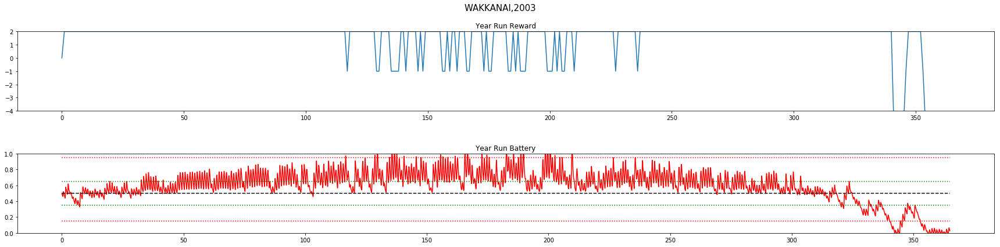

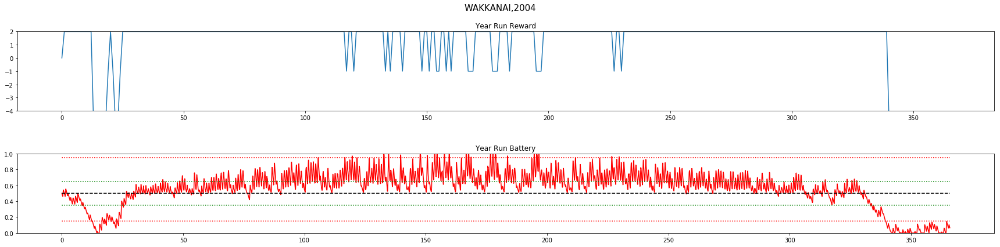

...

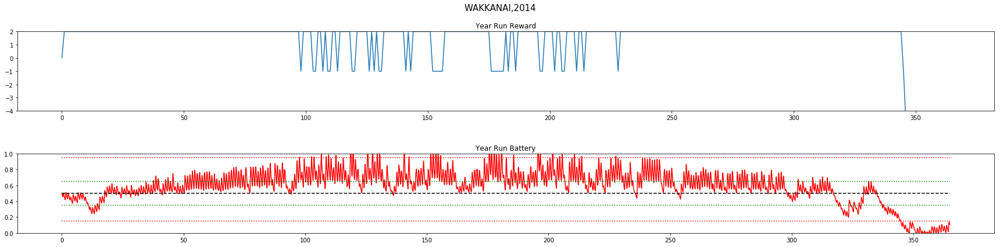

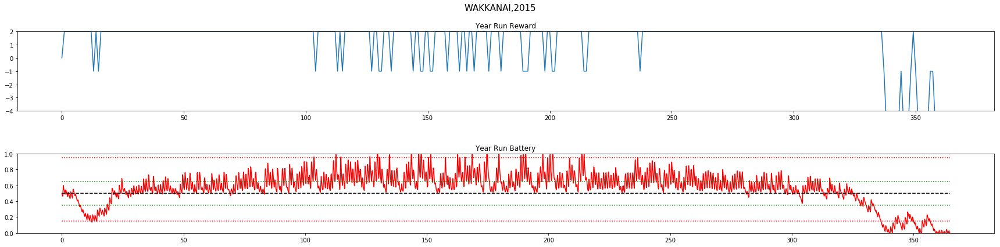

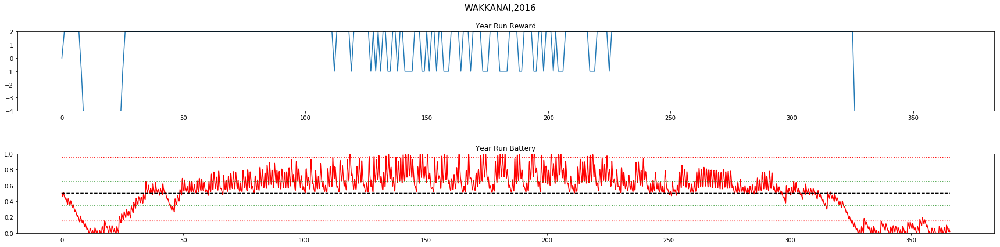

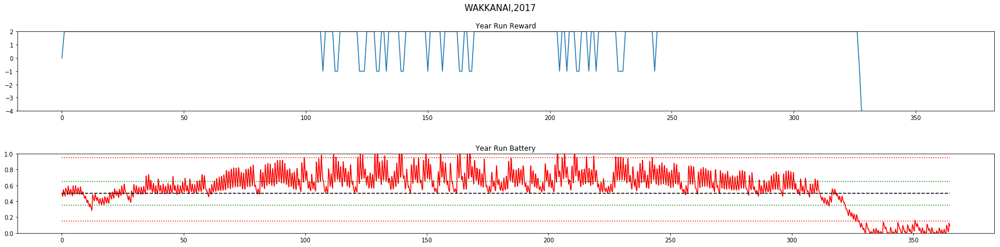

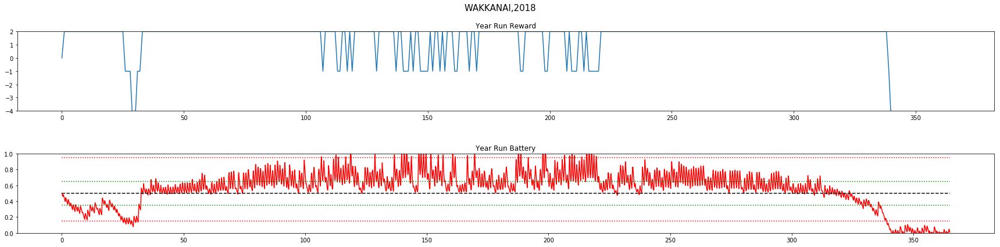



WAKKANAI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.07		64	 212
2001	 1.16		63	 299
2002	 0.98		71	 309
2003	 1.38		53	 151
2004	 1.11		61	 238
2005	 1.35		56	 63
2006	 1.24		56	 206
2007	 1.15		63	 256
2008	 1.22		58	 189
2009	 1.2		60	 115
2010	 1.27		59	 222
2011	 0.99		65	 272
2012	 1.1		60	 345
2013	 1.23		60	 216
2014	 1.31		57	 138
2015	 1.29		57	 115
2016	 0.54		100	 267
2017	 1.02		66	 263
2018	 1.11		70	 257

TOTAL Day Violations:   1199.0
TOTAL Batt Violations:  4133.0
************************************


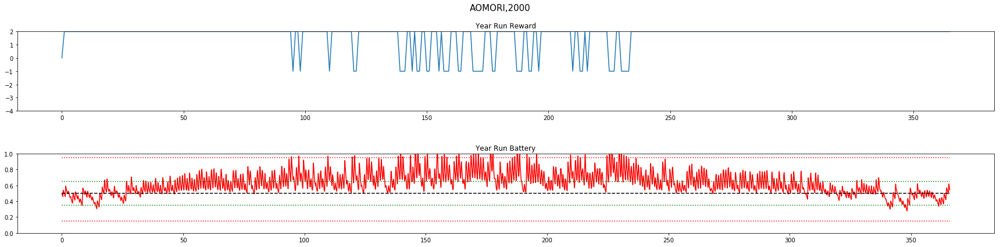

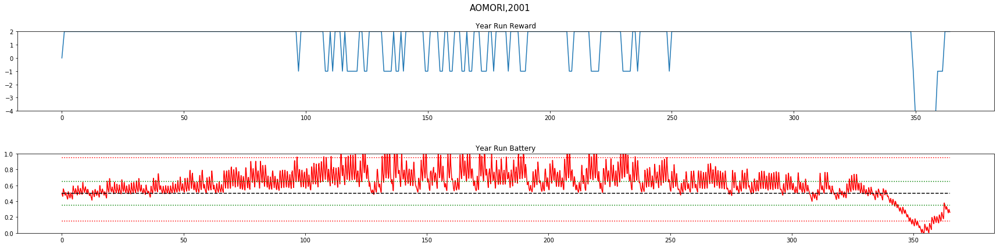

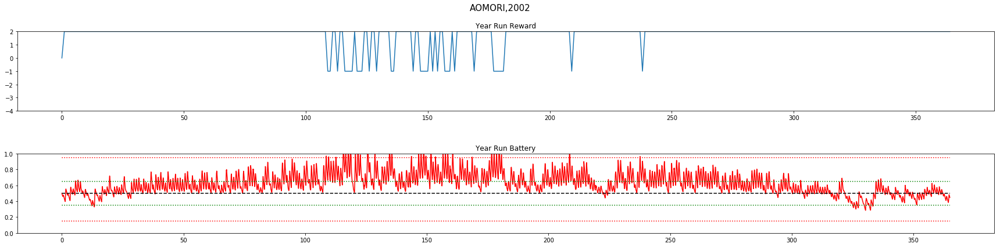

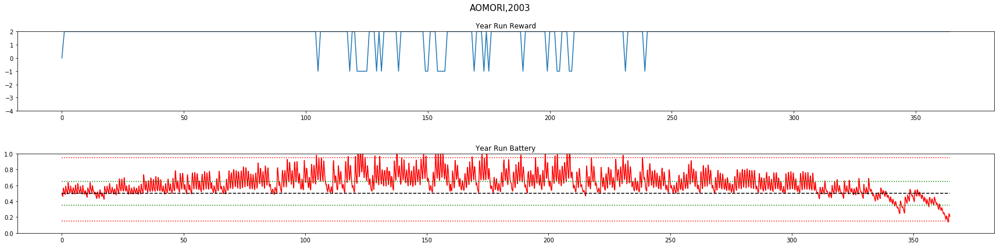

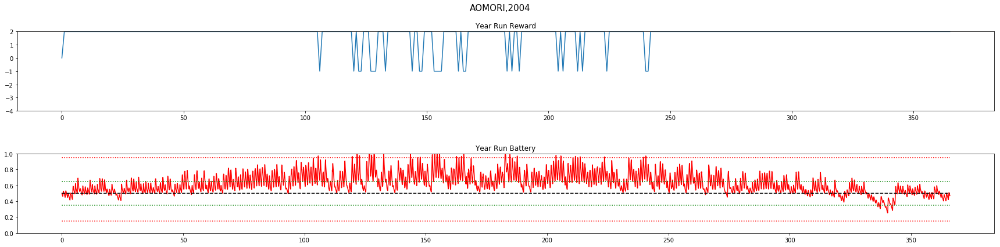

...

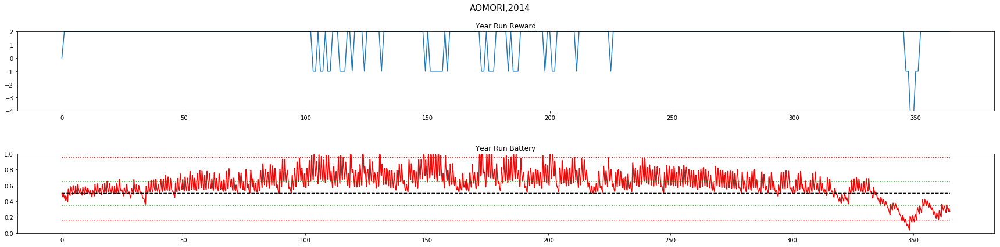

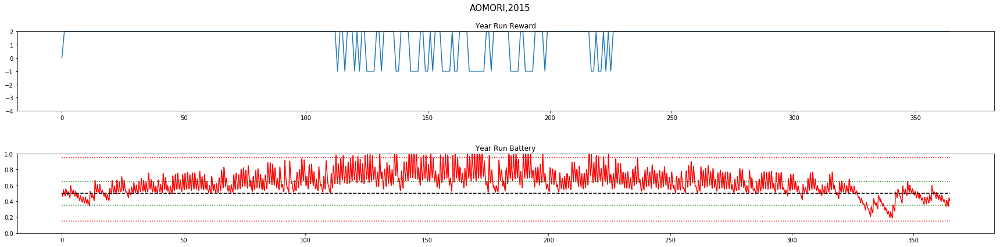

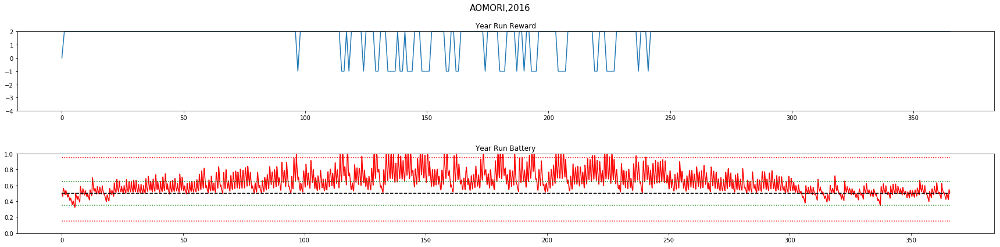

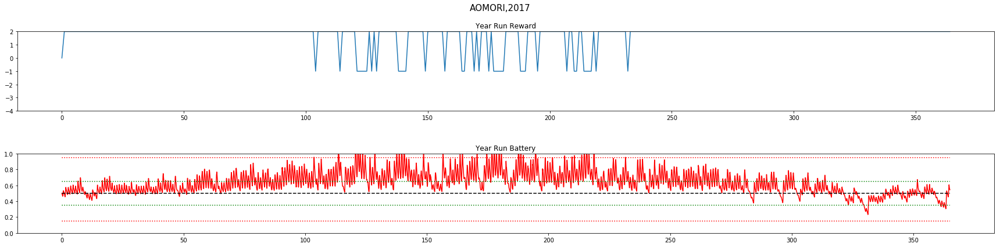

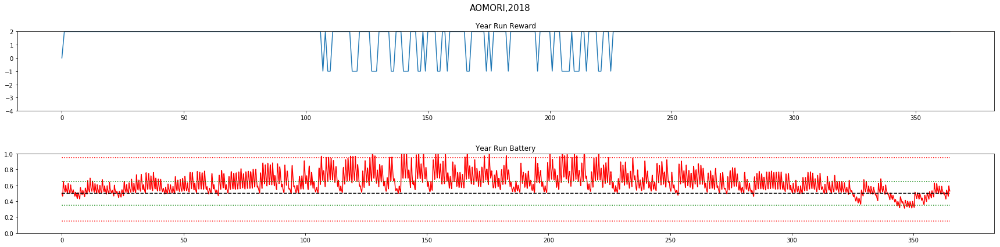



AOMORI
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.64		43	 38
2001	 1.38		62	 83
2002	 1.72		33	 54
2003	 1.77		28	 33
2004	 1.77		28	 22
2005	 1.72		33	 39
2006	 1.73		32	 50
2007	 1.61		47	 88
2008	 1.72		34	 62
2009	 1.74		32	 40
2010	 1.75		30	 37
2011	 1.53		45	 45
2012	 1.67		39	 65
2013	 1.75		30	 50
2014	 1.64		40	 50
2015	 1.61		47	 65
2016	 1.63		45	 92
2017	 1.68		38	 79
2018	 1.68		38	 36

TOTAL Day Violations:   724.0
TOTAL Batt Violations:  1028.0
************************************


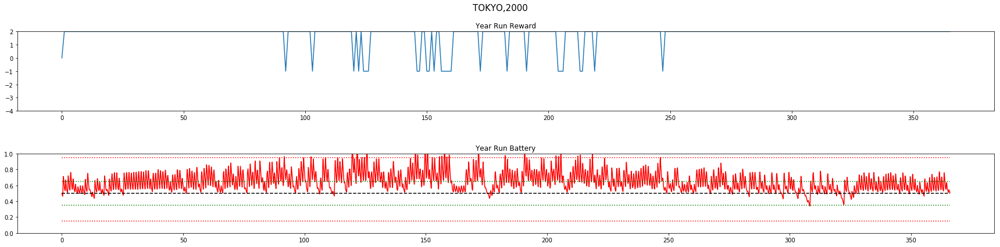

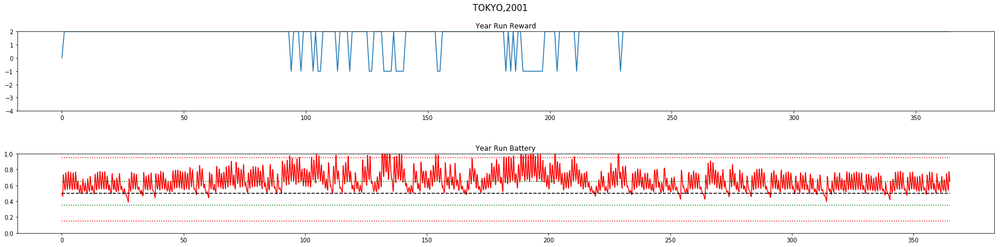

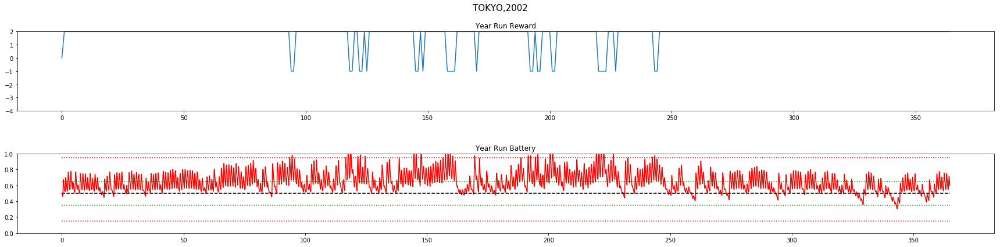

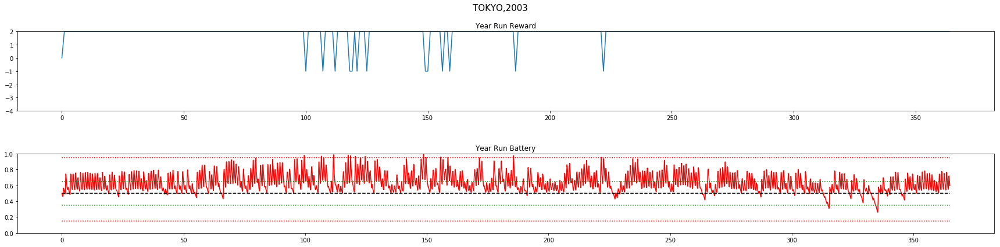

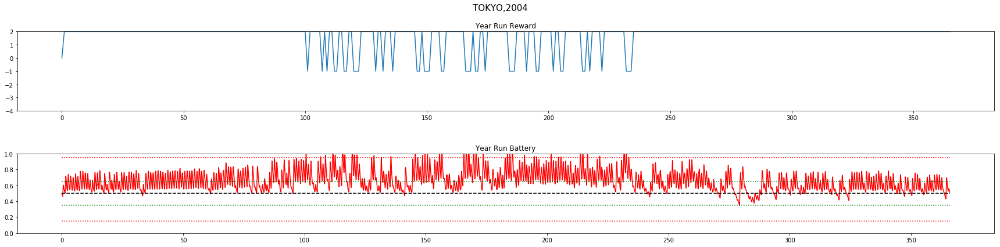

...

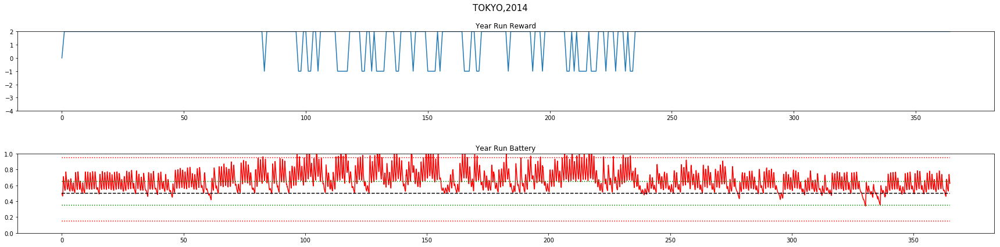

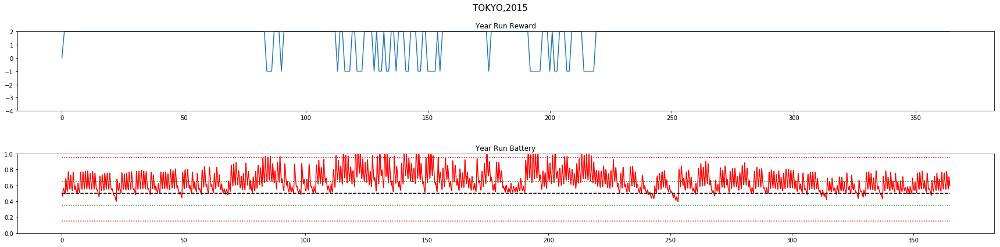

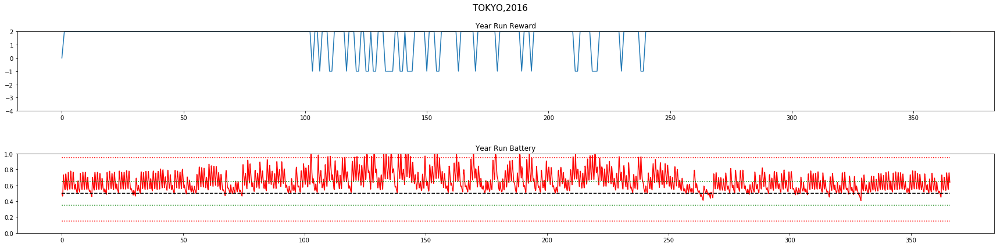

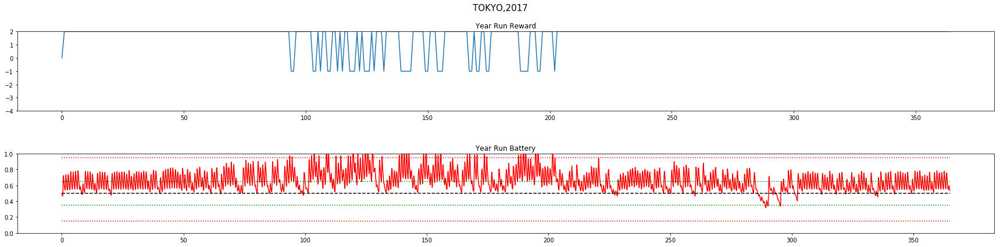

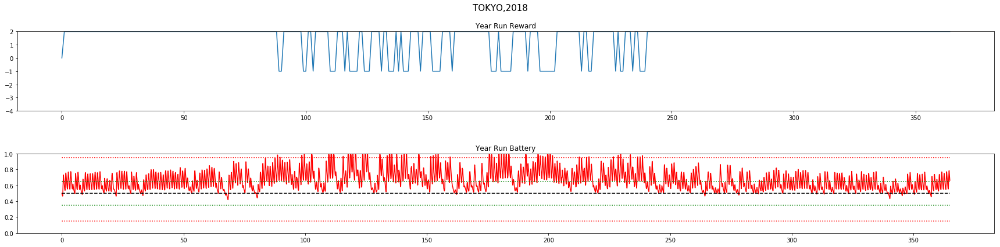



TOKYO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.77		27	 29
2001	 1.72		34	 28
2002	 1.76		28	 46
2003	 1.89		13	 3
2004	 1.65		42	 49
2005	 1.85		17	 18
2006	 1.88		14	 11
2007	 1.72		34	 34
2008	 1.85		18	 9
2009	 1.75		30	 23
2010	 1.67		39	 45
2011	 1.67		40	 41
2012	 1.63		44	 34
2013	 1.64		43	 68
2014	 1.59		49	 58
2015	 1.65		42	 49
2016	 1.7		36	 47
2017	 1.66		41	 56
2018	 1.53		56	 81

TOTAL Day Violations:   647.0
TOTAL Batt Violations:  729.0
************************************


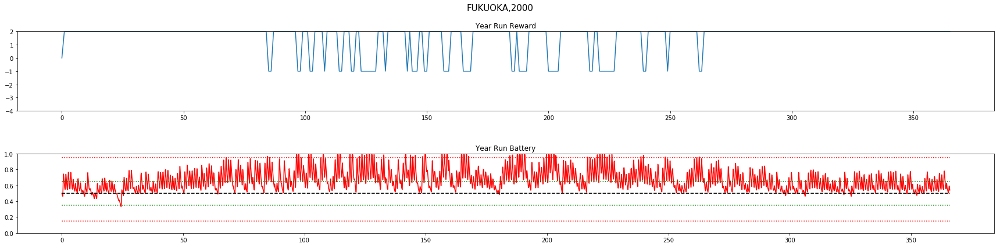

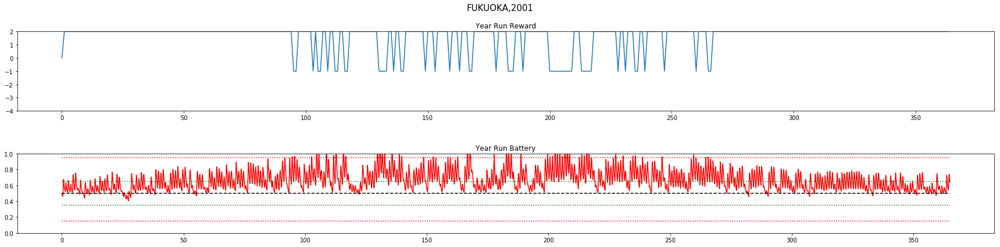

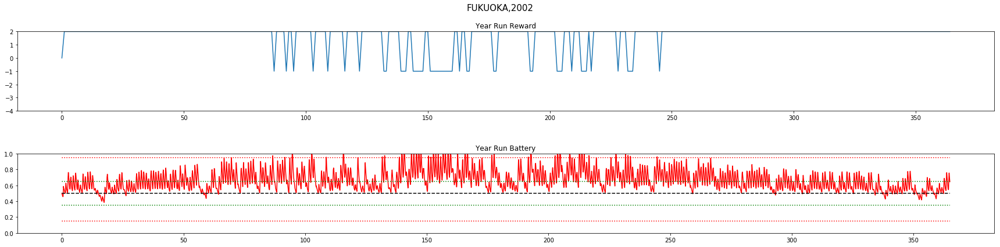

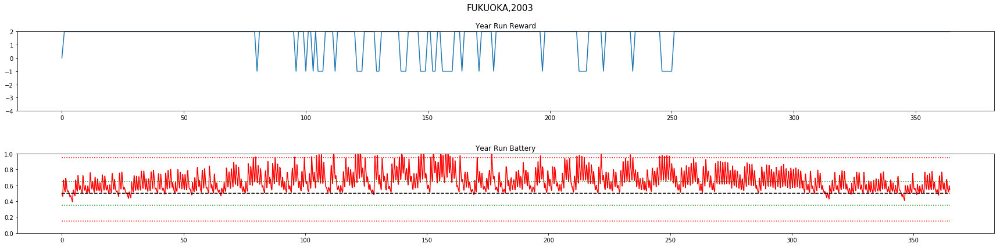

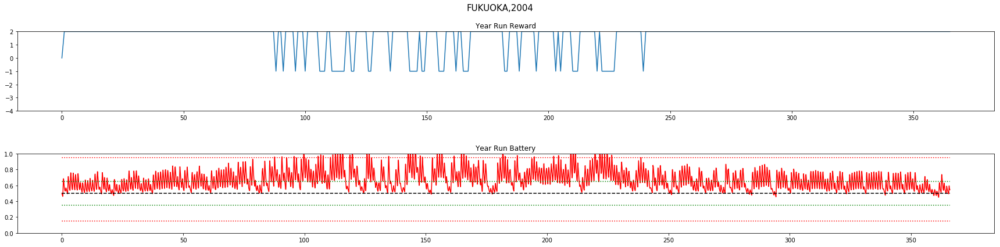

...

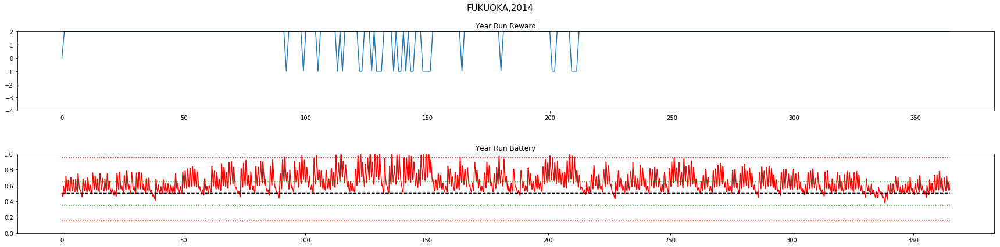

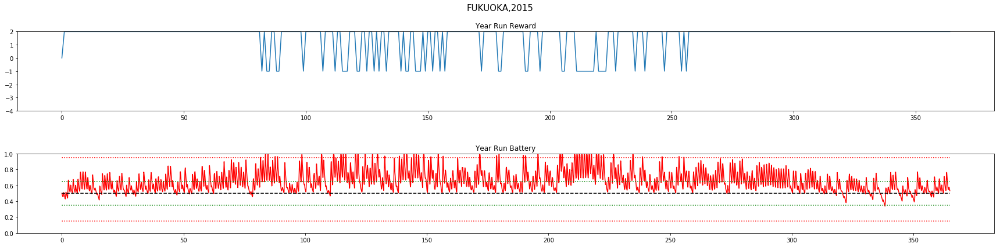

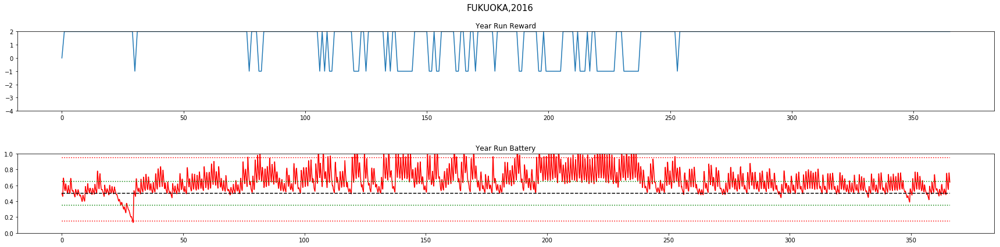

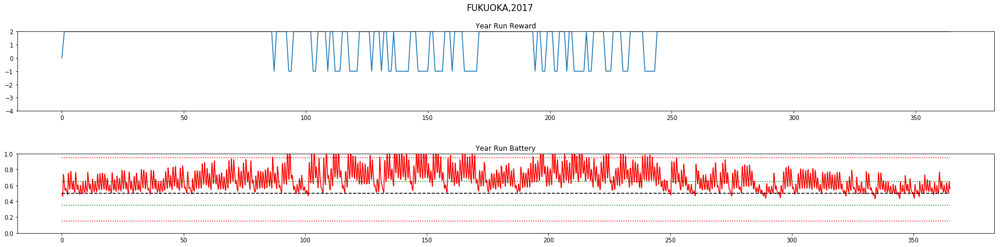

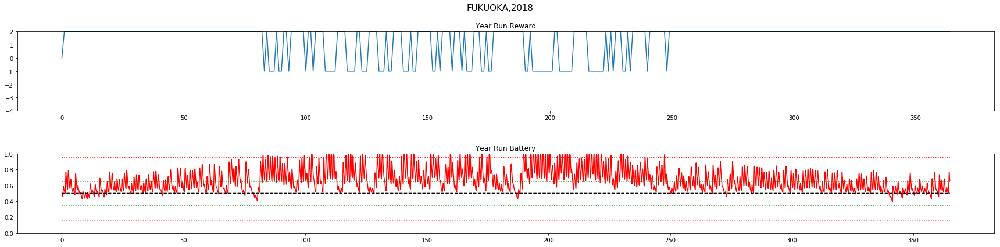



FUKUOKA
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.53		57	 75
2001	 1.57		52	 63
2002	 1.61		47	 74
2003	 1.66		41	 33
2004	 1.6		48	 68
2005	 1.53		56	 89
2006	 1.66		41	 49
2007	 1.56		53	 54
2008	 1.7		36	 38
2009	 1.56		53	 66
2010	 1.68		38	 53
2011	 1.79		25	 14
2012	 1.72		33	 15
2013	 1.67		40	 41
2014	 1.76		28	 22
2015	 1.56		53	 83
2016	 1.48		63	 81
2017	 1.48		63	 107
2018	 1.39		74	 121

TOTAL Day Violations:   901.0
TOTAL Batt Violations:  1146.0
************************************


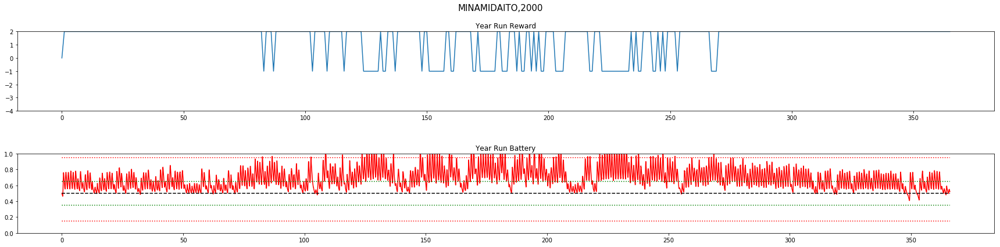

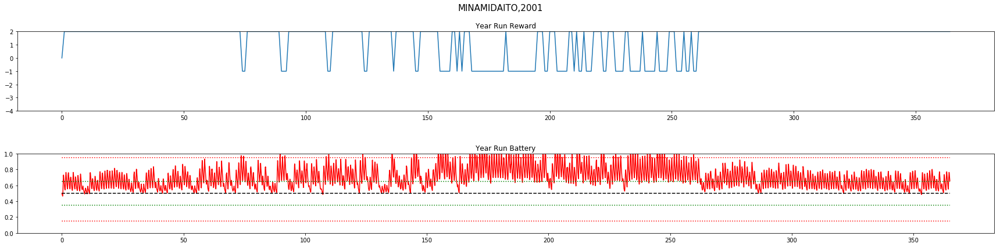

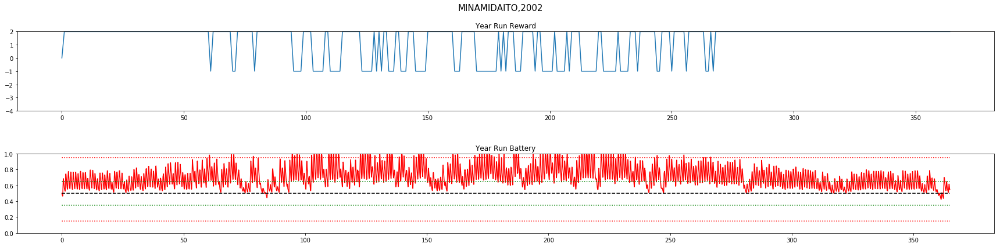

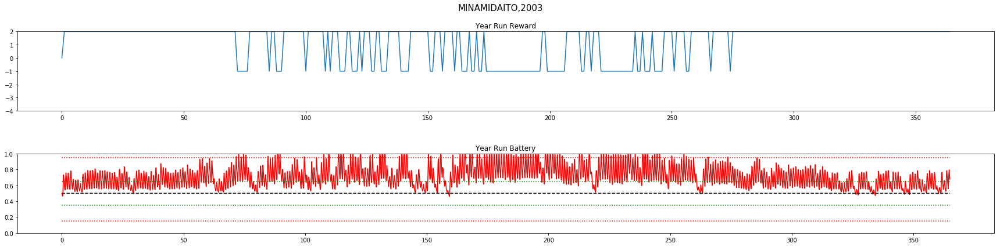

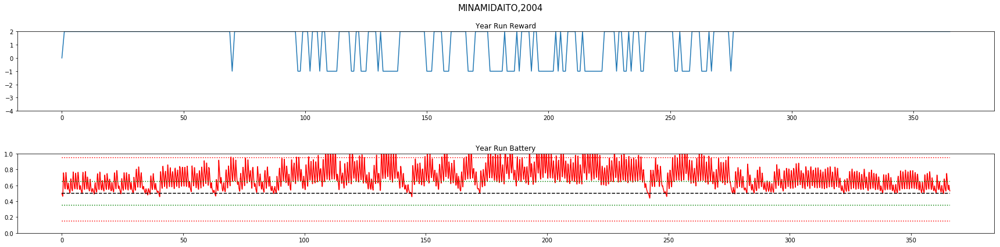

...

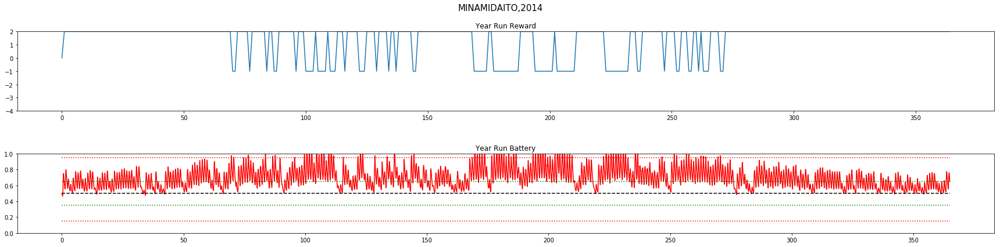

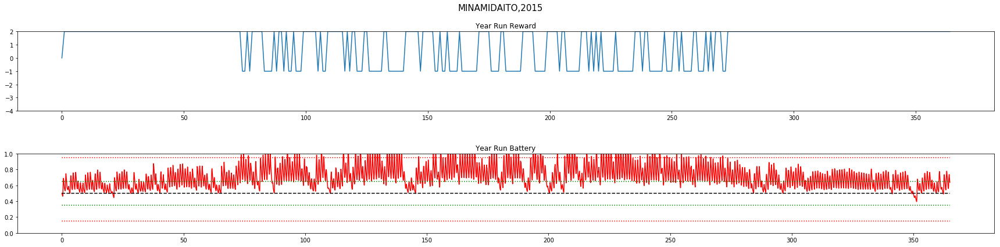

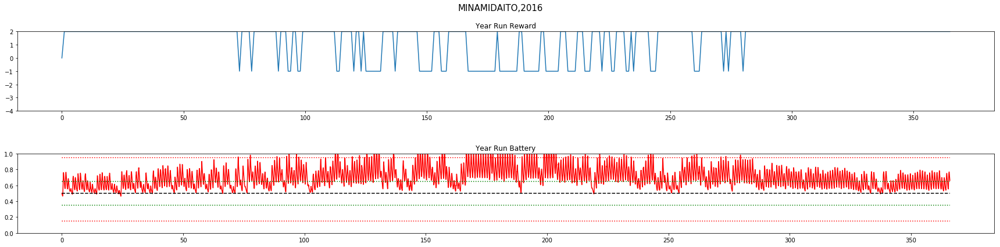

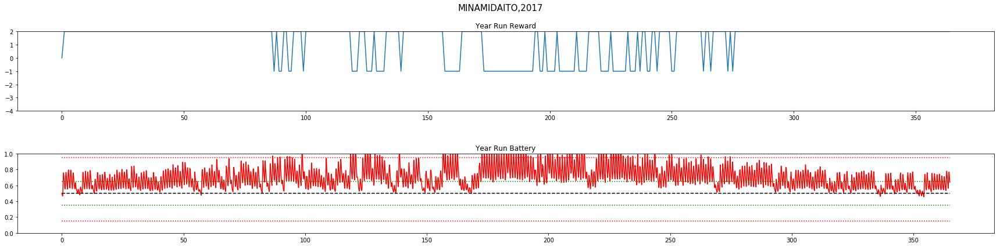

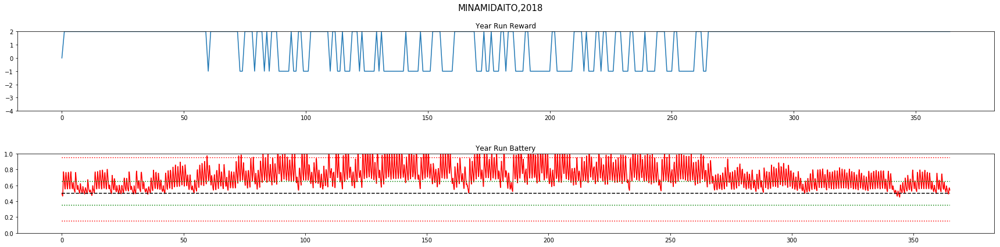



MINAMIDAITO
YEAR	AVG_RWD		VIOLATIONS
			DAY	BATT
2000	 1.4		73	 136
2001	 1.3		85	 135
2002	 1.26		89	 159
2003	 1.16		101	 179
2004	 1.33		81	 136
2005	 1.4		72	 96
2006	 1.16		101	 163
2007	 1.42		70	 106
2008	 1.44		68	 84
2009	 1.22		94	 168
2010	 1.39		73	 130
2011	 1.3		85	 144
2012	 1.52		56	 84
2013	 1.3		84	 156
2014	 1.31		83	 115
2015	 1.08		111	 196
2016	 1.31		83	 132
2017	 1.3		85	 157
2018	 1.07		112	 182

TOTAL Day Violations:   1606.0
TOTAL Batt Violations:  2658.0
************************************


In [22]:
#VALIDATION PHASE
print("***MEASURING PERFORMANCE OF THE MODEL***")
for LOCATION in ['wakkanai','aomori','tokyo','fukuoka','minamidaito']:
    results = np.empty(4)

    for YEAR in np.arange(2000,2019):
        capm      = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
        capm.eno  = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
        capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

        s, r, day_end, year_end = capm.reset()
        yr_test_record = np.empty(4)

        while True:
            a = dqn.choose_greedy_action(stdize(s))
            yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action
            s_, r, day_end, year_end = capm.step(a)
            if year_end:
                break
            s = s_

        yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
        yr_test_reward_rec = yr_test_record[:,2]
        yr_test_reward_rec = yr_test_reward_rec[::24] #annual average reward
        results = np.vstack((results, [int(YEAR), np.mean(yr_test_reward_rec), int(capm.violation_counter), int(capm.batt_violations)]))

    ###########################################################################################
    ###########################################################################################
        #     Plot the reward and battery for the entire year run
        title = LOCATION.upper() + ',' + str(YEAR)
        NO_OF_DAYS = capm.eno.NO_OF_DAYS

        fig = plt.figure(figsize=(24,6))
        fig.suptitle(title, fontsize=15)

        ax1 = fig.add_subplot(211)
        ax1.plot(yr_test_reward_rec)
        ax1.set_title("\n\nYear Run Reward")
        ax1.set_ylim([-4,2])

        ax2 = fig.add_subplot(212)
        ax2.plot(yr_test_record[:,0],'r')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
        ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')

        ax2.set_title("\n\nYear Run Battery")
        ax2.set_ylim([0,1])
        plt.sca(ax2)
        plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
        fig.tight_layout()
        plt.show()
    ###########################################################################################
    ###########################################################################################
    results = np.delete(results,0,0)
    print("\n")
    print(LOCATION.upper())
    print('YEAR\tAVG_RWD\t\tVIOLATIONS')
    print('\t\t\tDAY\tBATT')

    for x in np.arange(0,results.shape[0]):
        print('{}\t {}\t\t{}\t {}'.format(int(results[x,0]), np.around(results[x,1],2), int(results[x,2]), int(results[x,-1])))

    print("\nTOTAL Day Violations:  ",np.sum(results[:, 2]))
    print("TOTAL Batt Violations: ",np.sum(results[:,-1]))
    print("************************************")

In [23]:
print('\nRun time: {}'.format(datetime.now() - tic))


Run time: 0:34:58.752524


In [24]:
LOCATION = 'tokyo'
YEAR = 2000

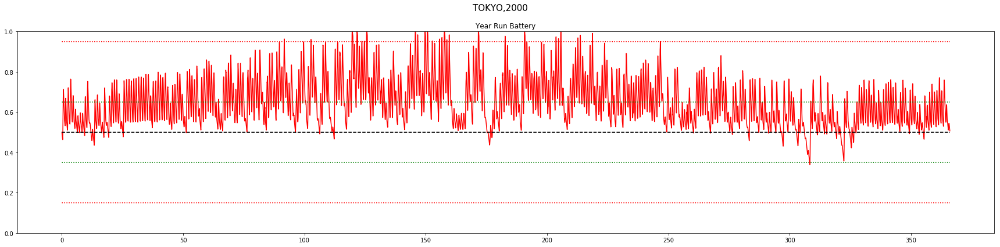

In [25]:
capm = CAPM(LOCATION,YEAR,shuffle=False, trainmode=False) #instantiate the CAPM class
capm.eno = ENO(LOCATION,YEAR, shuffle=False, day_balance=False) #instantiate the environment inside the CAPM class
capm.HMAX = capm.eno.SMAX #maximum power output of solar cell is set in CAPM object using the value in ENO object

s, r, day_end, year_end = capm.reset()
yr_test_record = np.empty(4)

while True:
    a = dqn.choose_greedy_action(stdize(s))

    #state = [batt, enp, henergy, fcast]
    yr_test_record = np.vstack((yr_test_record, [s[0],s[2],r, a])) #record battery, henergy, reward and action

    # take action
    s_, r, day_end, year_end = capm.step(a)

    if year_end:
        break

    s = s_

yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
yr_test_reward_rec = yr_test_record[:,2]
yr_test_reward_rec = yr_test_reward_rec[::24]

title = LOCATION.upper() + ',' + str(YEAR)
NO_OF_DAYS = capm.eno.NO_OF_DAYS

fig = plt.figure(figsize=(24,6))
fig.suptitle(title, fontsize=15)

#     ax1 = fig.add_subplot(211)
#     ax1.plot(yr_test_reward_rec)
#     ax1.set_title("\n\nYear Run Reward")
#     ax1.set_ylim([-3,3])

#Plot the reward and battery for the entire year run
ax2 = fig.add_subplot(111)
ax2.plot(yr_test_record[:,0],'r')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BOPT/capm.BMAX, 'k--')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_LO/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*capm.BLIM_HI/capm.BMAX, 'r:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:')
ax2.plot(np.ones_like(yr_test_record[:,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:')
ax2.set_title("\n\nYear Run Battery")
ax2.set_ylim([0,1])
plt.sca(ax2)
plt.xticks(np.arange(0, NO_OF_DAYS*24, 50*24),np.arange(0,NO_OF_DAYS,50))
fig.tight_layout()
plt.show()

In [26]:
DAY_START = 320
DAY_END   = 325

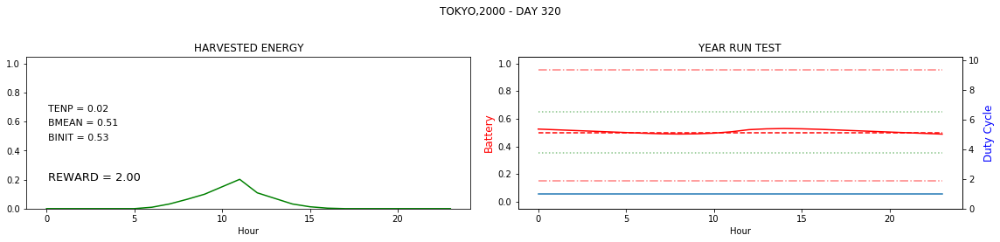

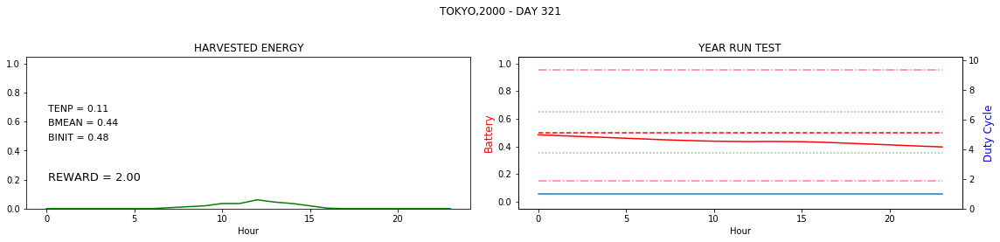

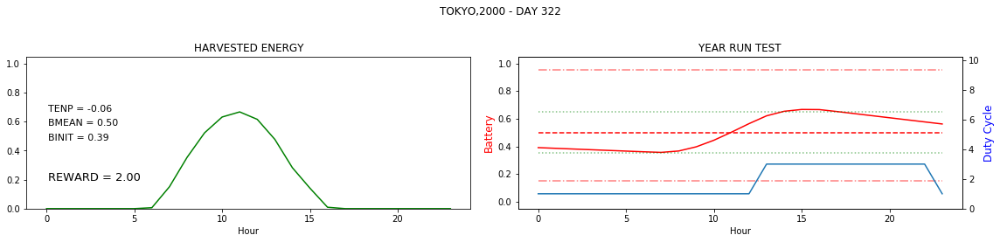

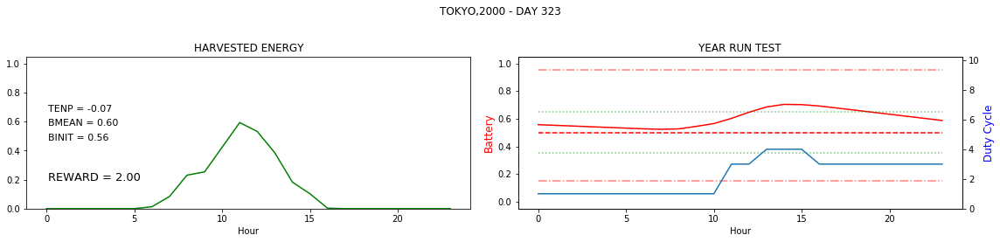

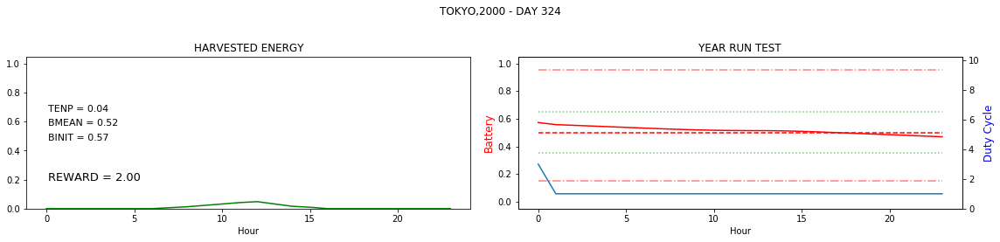

In [27]:
#Plot the reward and battery for the entire year run on a day by day basis
title = LOCATION.upper() + ',' + str(YEAR)
TIME_AXIS = np.arange(0,capm.eno.TIME_STEPS)
for DAY in range(DAY_START,DAY_END):
    START = DAY*24
    END = START+24

    daytitle = title + ' - DAY ' + str(DAY)
    fig = plt.figure(figsize=(16,4))
    st = fig.suptitle(daytitle)

    ax2 = fig.add_subplot(121)
    ax2.plot(yr_test_record[START:END,1],'g')
    ax2.set_title("HARVESTED ENERGY")
    ax2.set_xlabel("Hour")
    ax2.set_ylim([0,1.05])
    
    ax2.text(0.1, 0.6, "TENP = %.2f\n" %(capm.BOPT/capm.BMAX-yr_test_record[END,0]),fontsize=11, ha='left')
    ax2.text(0.1, 0.5, "BMEAN = %.2f\n" %(np.mean(yr_test_record[START:END,0])),fontsize=11, ha='left')
    ax2.text(0.1, 0.4, "BINIT = %.2f\n" %(yr_test_record[START,0]),fontsize=11, ha='left')
    if END < (capm.eno.NO_OF_DAYS*capm.eno.TIME_STEPS):
        ax2.text(0.1, 0.1, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=13, ha='left')
        
    #plot battery for year run
    ax1 = fig.add_subplot(122)
    ax1.plot(TIME_AXIS,              yr_test_record[START:END,0],'r')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BOPT/capm.BMAX, 'r--')
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_LO/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*capm.BLIM_HI/capm.BMAX, 'r-.',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT+capm.ENP_MARGIN /2) /capm.BMAX, 'g:',alpha=0.5)
    ax1.plot(TIME_AXIS, np.ones_like(yr_test_record[START:END,0])*(capm.BOPT-capm.ENP_MARGIN/2)/capm.BMAX, 'g:',alpha=0.5)
    
    ax1.set_title("YEAR RUN TEST")
    ax1.set_xlabel("Hour")
    ax1.set_ylabel('Battery', color='r',fontsize=12)
    ax1.set_ylim([-0.05,1.05])

    #plot actions for year run
    ax1a = ax1.twinx()
    ax1a.plot(yr_test_record[START:END,3]+1)
    ax1a.set_ylim([0,N_ACTIONS])
    ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)
    ax1a.set_ylim([0,10.25])


    fig.tight_layout()
    st.set_y(0.95)
    fig.subplots_adjust(top=0.75)
    plt.show()